In [1]:
# Install data manipulation libraries
!pip install numpy pandas pandas_datareader

# Install visualization libraries
!pip install matplotlib seaborn plotly

# Install financial data libraries
!pip install yfinance yoptions

# Install scientific computing libraries
!pip install scipy scikit-learn statsmodels
!pip install -U kaleido

In [2]:
# Data manipulation libraries
import pandas as pd
import numpy as np
from pandas_datareader import data as pdr

# Visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

# Financial data libraries
import yfinance as yf

# Date and time libraries
from datetime import datetime, timedelta

# Scientific computing libraries
from scipy.stats import linregress, skew, kurtosis
from scipy.optimize import minimize
from math import pi

# Machine learning libraries
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Warnings
import warnings
# Suppress the specific FutureWarning
warnings.filterwarnings("ignore", category=FutureWarning, message="The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.")

In [3]:

# Define the list of tickers for potential portfolio composition
tickers = ['SPY', 'QQQ', 'QLC', 'IWM', 'DAX', 
           'XLK', 'XLF', 'XLV', 'XLE', 'XLY', 'XLP', 'XLI', 'XLU', 'XLB', 'XLRE', 'XLC', 
           'TQQQ', 'UPRO', 'TECL', 'TECS', 'FAS', 'FAZ', 'ERX', 'ERY', 'SOXL', 'SPXS', 
           'VIX', 'UVXY',
           'SPYD', 'SPYI', 'O', 'JEPI',
           'TSLA', 'NVDA', 'AMD', 'INTC', 'NVDL', 'TSLL']


In [ ]:
# Create a directory for raw data if it doesn't exist
import os

output_dir = 'raw_data'
os.makedirs(output_dir, exist_ok=True)

# Iterate through each ticker and save the data to CSV
for ticker in tickers:
    # Assuming 'data' is defined and contains the relevant data for each ticker
    ticker_data = yf.download(ticker)  # Fetch data for the ticker
    ticker_data.to_csv(f'{output_dir}/{ticker}_analyzed_output.csv')

# Technical Features

In [ ]:
class SPYDataAnalyzer:
    def __init__(self, years=10, cache_file='spy_data.csv'):
        self.years = years
        self.cache_file = cache_file
        self.data = None
    
    def fetch_data(self):
        # Check if data is cached and is up-to-date
        if os.path.exists(self.cache_file):
            modified_time = datetime.fromtimestamp(os.path.getmtime(self.cache_file))
            if datetime.now() - modified_time < timedelta(days=1):
                self.data = pd.read_csv(self.cache_file, parse_dates=['Date'], index_col='Date')
                return

        # Fetch data from Yahoo Finance
        end_date = datetime.now()
        start_date = end_date - timedelta(days=self.years * 365)
        spy = yf.download('SPY', start=start_date, end=end_date)
        self.data = spy[['Open', 'High', 'Low', 'Close']]
        self.data.to_csv(self.cache_file)
    
    def calculate_indicators(self):
        if self.data is None:
            raise ValueError("No data available. Please fetch data first.")
        
        # Calculate moving averages
        self.data['20_MA'] = self.data['Close'].rolling(window=20).mean()
        self.data['52_Week_MA'] = self.data['Close'].rolling(window=260).mean()
        
        # Calculate Bollinger Bands for 20-day and 52-week
        self.data['20_Upper_BB'] = self.data['20_MA'] + 2 * self.data['Close'].rolling(window=20).std()
        self.data['20_Lower_BB'] = self.data['20_MA'] - 2 * self.data['Close'].rolling(window=20).std()
        self.data['52_Upper_BB'] = self.data['52_Week_MA'] + 2 * self.data['Close'].rolling(window=260).std()
        self.data['52_Lower_BB'] = self.data['52_Week_MA'] - 2 * self.data['Close'].rolling(window=260).std()
        
        # Calculate daily returns and other statistics
        self.data['Daily_Return'] = self.data['Close'].pct_change()
        self.data['Cumulative_Return'] = (1 + self.data['Daily_Return']).cumprod() - 1
        self.data['Std_Dev'] = self.data['Daily_Return'].rolling(window=20).std()
        
        # Calculate statistical metrics only where there are enough data points
        self.data['Skewness'] = self.data['Daily_Return'].rolling(window=20).apply(lambda x: skew(x.dropna()), raw=False)
        self.data['Kurtosis'] = self.data['Daily_Return'].rolling(window=20).apply(lambda x: kurtosis(x.dropna()), raw=False)
        self.data['Positive_Return_Percentage'] = self.data['Daily_Return'].rolling(window=20).apply(lambda x: (x > 0).mean() * 100, raw=False)
        
        # Calculate Kelly ratio and fraction based on available returns
        win_rate = self.data['Positive_Return_Percentage'] / 100
        loss_rate = 1 - win_rate
        avg_win = self.data[self.data['Daily_Return'] > 0]['Daily_Return'].mean()
        avg_loss = abs(self.data[self.data['Daily_Return'] <= 0]['Daily_Return'].mean())
        self.data['Kelly_Ratio'] = win_rate - (loss_rate / (avg_win / avg_loss))
        self.data['Kelly_Fraction'] = self.data['Kelly_Ratio'] / 2
        
        # Drop initial rows with NaN values after calculations
        self.data.dropna(inplace=True)

    def get_data(self):
        return self.data
    
    def save_to_csv(self, filename='spy_analyzed_data.csv'):
        if self.data is not None:
            self.data.to_csv(filename)
        else:
            raise ValueError("No data available to save. Please fetch and process data first.")

# Example usage
analyzer = SPYDataAnalyzer(years=10)
analyzer.fetch_data()
analyzer.calculate_indicators()
data = analyzer.get_data()
# print(data.head())
# data.to_csv('spy_analyzed_output.csv')


# Technical Seasonality Analyzer

In [ ]:
class TechnicalSeasonalityAnalyzer:
    def __init__(self, tickers=['SPY', 'QQQ', 'IWM', 'QLC', 'DAX', 'SOXL'], start_date='2010-01-01', end_date=None):
        self.tickers = tickers
        self.start_date = start_date
        self.end_date = end_date if end_date else datetime.now().strftime('%Y-%m-%d')
        self.data = None

    def fetch_data(self):
        self.data = yf.download(self.tickers, start=self.start_date, end=self.end_date)

    def calculate_technical_indicators(self):
        new_columns = {}
        for ticker in self.tickers:
            close_price = self.data[('Close', ticker)]
            high_price = self.data[('High', ticker)]
            low_price = self.data[('Low', ticker)]
            volume = self.data[('Volume', ticker)]
            
            # Existing indicators
            new_columns[f'{ticker}_20D_MA'] = close_price.rolling(window=20).mean()
            new_columns[f'{ticker}_20D_STD'] = close_price.rolling(window=20).std()
            new_columns[f'{ticker}_20D_Upper'] = new_columns[f'{ticker}_20D_MA'] + 2 * new_columns[f'{ticker}_20D_STD']
            new_columns[f'{ticker}_20D_Lower'] = new_columns[f'{ticker}_20D_MA'] - 2 * new_columns[f'{ticker}_20D_STD']
            
            new_columns[f'{ticker}_52W_MA'] = close_price.rolling(window=252).mean()
            new_columns[f'{ticker}_52W_STD'] = close_price.rolling(window=252).std()
            new_columns[f'{ticker}_52W_Upper'] = new_columns[f'{ticker}_52W_MA'] + 2 * new_columns[f'{ticker}_52W_STD']
            new_columns[f'{ticker}_52W_Lower'] = new_columns[f'{ticker}_52W_MA'] - 2 * new_columns[f'{ticker}_52W_STD']
            
            delta = close_price.diff()
            gain = delta.clip(lower=0).rolling(window=14).mean()
            loss = -delta.clip(upper=0).rolling(window=14).mean()
            new_columns[f'{ticker}_RSI'] = 100 - (100 / (1 + gain / loss))

            # MACD
            exp1 = close_price.ewm(span=12, adjust=False).mean()
            exp2 = close_price.ewm(span=26, adjust=False).mean()
            new_columns[f'{ticker}_MACD'] = exp1 - exp2
            new_columns[f'{ticker}_MACD_Signal'] = new_columns[f'{ticker}_MACD'].ewm(span=9, adjust=False).mean()

            # Stochastic Oscillator
            low_14 = low_price.rolling(window=14).min()
            high_14 = high_price.rolling(window=14).max()
            new_columns[f'{ticker}_K'] = 100 * ((close_price - low_14) / (high_14 - low_14))
            new_columns[f'{ticker}_D'] = new_columns[f'{ticker}_K'].rolling(window=3).mean()

            # Trend-following indicator: ADX
            plus_dm = high_price.diff()
            minus_dm = low_price.diff()
            plus_dm[plus_dm < 0] = 0
            minus_dm[minus_dm > 0] = 0
            tr1 = pd.DataFrame(high_price - low_price)
            tr2 = pd.DataFrame(abs(high_price - close_price.shift(1)))
            tr3 = pd.DataFrame(abs(low_price - close_price.shift(1)))
            frames = [tr1, tr2, tr3]
            tr = pd.concat(frames, axis=1, join='inner').max(axis=1)
            atr = tr.rolling(14).mean()
            plus_di = 100 * (plus_dm.ewm(alpha=1/14).mean() / atr)
            minus_di = abs(100 * (minus_dm.ewm(alpha=1/14).mean() / atr))
            dx = (abs(plus_di - minus_di) / abs(plus_di + minus_di)) * 100
            new_columns[f'{ticker}_ADX'] = dx.ewm(alpha=1/14).mean()

            # Volume indicator: On-Balance Volume (OBV)
            new_columns[f'{ticker}_OBV'] = (volume * (~close_price.diff().le(0) * 2 - 1)).cumsum()

            # Momentum indicator: Rate of Change (ROC)
            new_columns[f'{ticker}_ROC'] = ((close_price - close_price.shift(10)) / close_price.shift(10)) * 100

        # Join all new columns at once
        self.data = pd.concat([self.data, pd.DataFrame(new_columns)], axis=1)

    def analyze_overbought_oversold(self):
        results = {}
        for ticker in self.tickers:
            overbought = (
                (self.data[f'{ticker}_RSI'] > 70) |
                (self.data[('Close', ticker)] > self.data[f'{ticker}_20D_Upper']) |
                (self.data[('Close', ticker)] > self.data[f'{ticker}_52W_Upper']) |
                (self.data[f'{ticker}_K'] > 80) |
                (self.data[f'{ticker}_D'] > 80) |
                (self.data[f'{ticker}_MACD'] > self.data[f'{ticker}_MACD_Signal']) |
                (self.data[f'{ticker}_ROC'] > 10)
            )
            oversold = (
                (self.data[f'{ticker}_RSI'] < 30) |
                (self.data[('Close', ticker)] < self.data[f'{ticker}_20D_Lower']) |
                (self.data[('Close', ticker)] < self.data[f'{ticker}_52W_Lower']) |
                (self.data[f'{ticker}_K'] < 20) |
                (self.data[f'{ticker}_D'] < 20) |
                (self.data[f'{ticker}_MACD'] < self.data[f'{ticker}_MACD_Signal']) |
                (self.data[f'{ticker}_ROC'] < -10)
            )
            
            monthly_overbought = overbought.resample('M').mean()
            monthly_oversold = oversold.resample('M').mean()
            weekly_overbought = overbought.resample('W').mean()
            weekly_oversold = oversold.resample('W').mean()
            
            results[ticker] = {
                'monthly_overbought': monthly_overbought,
                'monthly_oversold': monthly_oversold,
                'weekly_overbought': weekly_overbought,
                'weekly_oversold': weekly_oversold
            }
        
        return results

    def analyze_indicators(self):
        results = {}
        for ticker in self.tickers:
            results[ticker] = {
                'RSI': self.data[f'{ticker}_RSI'],
                'MACD': self.data[f'{ticker}_MACD'],
                'MACD_Signal': self.data[f'{ticker}_MACD_Signal'],
                'K': self.data[f'{ticker}_K'],
                'D': self.data[f'{ticker}_D'],
                'ADX': self.data[f'{ticker}_ADX'],
                'OBV': self.data[f'{ticker}_OBV'],
                'ROC': self.data[f'{ticker}_ROC'],
                '20D_Upper': self.data[f'{ticker}_20D_Upper'],
                '20D_Lower': self.data[f'{ticker}_20D_Lower'],
                '52W_Upper': self.data[f'{ticker}_52W_Upper'],
                '52W_Lower': self.data[f'{ticker}_52W_Lower'],
                'Close': self.data[('Close', ticker)]
            }
        return results

    def plot_overbought_oversold(self, overbought_oversold_results):
        for ticker in self.tickers:
            fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 12))
            
            # Monthly plot
            monthly_data = overbought_oversold_results[ticker]['monthly_overbought'].groupby(overbought_oversold_results[ticker]['monthly_overbought'].index.month).mean()
            monthly_data = monthly_data.reindex(range(1, 13))
            ax1.bar(monthly_data.index, monthly_data.values, alpha=0.7, color='#8B0000', label='Overbought')
            
            monthly_data = overbought_oversold_results[ticker]['monthly_oversold'].groupby(overbought_oversold_results[ticker]['monthly_oversold'].index.month).mean()
            monthly_data = monthly_data.reindex(range(1, 13))
            ax1.bar(monthly_data.index, monthly_data.values, alpha=0.7, color='#00008B', label='Oversold')
            
            ax1.set_title(f'{ticker} Monthly Overbought/Oversold Probability')
            ax1.set_xlabel('Month')
            ax1.set_ylabel('Probability')
            ax1.set_xticks(range(1, 13))
            ax1.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
            ax1.legend()
            
            # Weekly plot
            weekly_data = overbought_oversold_results[ticker]['weekly_overbought'].groupby(overbought_oversold_results[ticker]['weekly_overbought'].index.isocalendar().week).mean()
            weekly_data = weekly_data.reindex(range(1, 53))
            ax2.plot(weekly_data.index, weekly_data.values, color='#8B0000', linewidth=2, label='Overbought')
            
            weekly_data = overbought_oversold_results[ticker]['weekly_oversold'].groupby(overbought_oversold_results[ticker]['weekly_oversold'].index.isocalendar().week).mean()
            weekly_data = weekly_data.reindex(range(1, 53))
            ax2.plot(weekly_data.index, weekly_data.values, color='#00008B', linewidth=2, label='Oversold')
            
            ax2.set_title(f'{ticker} Weekly Overbought/Oversold Probability')
            ax2.set_xlabel('Week of the Year')
            ax2.set_ylabel('Probability')
            ax2.set_xticks(range(1, 53, 4))
            ax2.legend()
            
            plt.tight_layout()
            plt.show()

    def run_analysis(self):
        self.fetch_data()
        self.calculate_technical_indicators()
        overbought_oversold_results = self.analyze_overbought_oversold()
        indicator_results = self.analyze_indicators()
        self.plot_overbought_oversold(overbought_oversold_results)

# Example usage
analyzer = TechnicalSeasonalityAnalyzer()
analyzer.run_analysis()


In [ ]:
# Removed the installation command for kaleido as it should be installed outside of the script.
class TechnicalSeasonalityAnalyzer:
    """
    A class to analyze the technical seasonality of financial instruments.

    Attributes:
        tickers (list): A list of ticker symbols for the financial instruments to analyze.
        start_date (str): The start date for fetching historical data in 'YYYY-MM-DD' format.
        end_date (str): The end date for fetching historical data in 'YYYY-MM-DD' format. Defaults to the current date.
        data (DataFrame): A DataFrame to store the fetched historical data.

    Methods:
        fetch_data(): Fetches historical data for the specified tickers from Yahoo Finance.
        calculate_technical_indicators(indicators, use_20d_bands, use_52w_bands): Calculates various technical indicators.
        analyze_overbought_oversold(indicators, use_20d_bands, use_52w_bands): Analyzes overbought and oversold conditions.
        analyze_indicators(indicators, use_20d_bands, use_52w_bands): Analyzes the specified technical indicators.
        plot_results(overbought_oversold_results, indicator_results, indicators, use_20d_bands, use_52w_bands, export_visuals): Plots the results of the analysis and optionally exports visualizations.
        run_analysis(indicators, use_20d_bands, use_52w_bands, export_visuals): Executes the full analysis workflow.
    """

    def __init__(self, tickers=['SPY', 'QQQ'], start_date='2010-01-01', end_date=None):
        """
        Initializes the TechnicalSeasonalityAnalyzer with the specified tickers and date range.

        Parameters:
            tickers (list): A list of ticker symbols to analyze.
            start_date (str): The start date for fetching data.
            end_date (str): The end date for fetching data. Defaults to the current date.
        """
        self.tickers = tickers
        self.start_date = start_date
        self.end_date = end_date if end_date else datetime.now().strftime('%Y-%m-%d')
        self.data = None

    def fetch_data(self):
        """Fetches historical data for the specified tickers from Yahoo Finance."""
        self.data = yf.download(self.tickers, start=self.start_date, end=self.end_date)

    def calculate_technical_indicators(self, indicators=['RSI', 'MACD', 'K', 'D', 'ADX', 'OBV', 'ROC'], use_20d_bands=True, use_52w_bands=True):
        """
        Calculates various technical indicators for the specified tickers.

        Parameters:
            indicators (list): A list of technical indicators to calculate.
            use_20d_bands (bool): Whether to calculate 20-day moving average bands.
            use_52w_bands (bool): Whether to calculate 52-week moving average bands.
        """
        new_columns = {}
        for ticker in self.tickers:
            close_price = self.data[('Close', ticker)]
            high_price = self.data[('High', ticker)]
            low_price = self.data[('Low', ticker)]
            volume = self.data[('Volume', ticker)]

            # Calculate 20-day moving average and standard deviation bands
            if use_20d_bands:
                new_columns[f'{ticker}_20D_MA'] = close_price.rolling(window=20).mean()
                new_columns[f'{ticker}_20D_STD'] = close_price.rolling(window=20).std()
                new_columns[f'{ticker}_20D_Upper'] = new_columns[f'{ticker}_20D_MA'] + 2 * new_columns[f'{ticker}_20D_STD']
                new_columns[f'{ticker}_20D_Lower'] = new_columns[f'{ticker}_20D_MA'] - 2 * new_columns[f'{ticker}_20D_STD']

            # Calculate 52-week moving average and standard deviation bands
            if use_52w_bands:
                new_columns[f'{ticker}_52W_MA'] = close_price.rolling(window=252).mean()
                new_columns[f'{ticker}_52W_STD'] = close_price.rolling(window=252).std()
                new_columns[f'{ticker}_52W_Upper'] = new_columns[f'{ticker}_52W_MA'] + 2 * new_columns[f'{ticker}_52W_STD']
                new_columns[f'{ticker}_52W_Lower'] = new_columns[f'{ticker}_52W_MA'] - 2 * new_columns[f'{ticker}_52W_STD']

            # Calculate Relative Strength Index (RSI)
            if 'RSI' in indicators:
                delta = close_price.diff()
                gain = delta.clip(lower=0).rolling(window=14).mean()
                loss = -delta.clip(upper=0).rolling(window=14).mean()
                new_columns[f'{ticker}_RSI'] = 100 - (100 / (1 + gain / loss))

            # Calculate Moving Average Convergence Divergence (MACD)
            if 'MACD' in indicators:
                exp1 = close_price.ewm(span=12, adjust=False).mean()
                exp2 = close_price.ewm(span=26, adjust=False).mean()
                new_columns[f'{ticker}_MACD'] = exp1 - exp2
                new_columns[f'{ticker}_MACD_Signal'] = new_columns[f'{ticker}_MACD'].ewm(span=9, adjust=False).mean()

            # Calculate Stochastic Oscillator (K and D)
            if 'K' in indicators or 'D' in indicators:
                low_14 = low_price.rolling(window=14).min()
                high_14 = high_price.rolling(window=14).max()
                new_columns[f'{ticker}_K'] = 100 * ((close_price - low_14) / (high_14 - low_14))
                new_columns[f'{ticker}_D'] = new_columns[f'{ticker}_K'].rolling(window=3).mean()

            # Calculate Average Directional Index (ADX)
            if 'ADX' in indicators:
                plus_dm = high_price.diff()
                minus_dm = low_price.diff()
                plus_dm[plus_dm < 0] = 0
                minus_dm[minus_dm > 0] = 0
                tr1 = pd.DataFrame(high_price - low_price)
                tr2 = pd.DataFrame(abs(high_price - close_price.shift(1)))
                tr3 = pd.DataFrame(abs(low_price - close_price.shift(1)))
                frames = [tr1, tr2, tr3]
                tr = pd.concat(frames, axis=1, join='inner').max(axis=1)
                atr = tr.rolling(14).mean()
                plus_di = 100 * (plus_dm.ewm(alpha=1/14).mean() / atr)
                minus_di = abs(100 * (minus_dm.ewm(alpha=1/14).mean() / atr))
                dx = (abs(plus_di - minus_di) / abs(plus_di + minus_di)) * 100
                new_columns[f'{ticker}_ADX'] = dx.ewm(alpha=1/14).mean()

            # Calculate On-Balance Volume (OBV)
            if 'OBV' in indicators:
                new_columns[f'{ticker}_OBV'] = (volume * (~close_price.diff().le(0) * 2 - 1)).cumsum()

            # Calculate Rate of Change (ROC)
            if 'ROC' in indicators:
                new_columns[f'{ticker}_ROC'] = ((close_price - close_price.shift(10)) / close_price.shift(10)) * 100

        # Join all new columns at once into the main data DataFrame
        self.data = pd.concat([self.data, pd.DataFrame(new_columns)], axis=1)

    def analyze_overbought_oversold(self, indicators=['RSI', 'MACD', 'K', 'D', 'ROC'], use_20d_bands=True, use_52w_bands=True):
        """
        Analyzes overbought and oversold conditions based on the specified indicators.

        Parameters:
            indicators (list): A list of indicators to use for the analysis.
            use_20d_bands (bool): Whether to consider 20-day moving average bands.
            use_52w_bands (bool): Whether to consider 52-week moving average bands.

        Returns:
            dict: A dictionary containing the overbought and oversold results for each ticker.
        """
        results = {}
        for ticker in self.tickers:
            overbought = pd.Series(False, index=self.data.index)
            oversold = pd.Series(False, index=self.data.index)

            # Check for overbought and oversold conditions based on 20-day bands
            if use_20d_bands:
                overbought |= self.data[('Close', ticker)] > self.data[f'{ticker}_20D_Upper']
                oversold |= self.data[('Close', ticker)] < self.data[f'{ticker}_20D_Lower']

            # Check for overbought and oversold conditions based on 52-week bands
            if use_52w_bands:
                overbought |= self.data[('Close', ticker)] > self.data[f'{ticker}_52W_Upper']
                oversold |= self.data[('Close', ticker)] < self.data[f'{ticker}_52W_Lower']

            # Check for overbought and oversold conditions based on RSI
            if 'RSI' in indicators:
                overbought |= self.data[f'{ticker}_RSI'] > 70
                oversold |= self.data[f'{ticker}_RSI'] < 30

            # Check for overbought and oversold conditions based on MACD
            if 'MACD' in indicators:
                overbought |= self.data[f'{ticker}_MACD'] > self.data[f'{ticker}_MACD_Signal']
                oversold |= self.data[f'{ticker}_MACD'] < self.data[f'{ticker}_MACD_Signal']

            # Check for overbought and oversold conditions based on Stochastic Oscillator
            if 'K' in indicators:
                overbought |= self.data[f'{ticker}_K'] > 80
                oversold |= self.data[f'{ticker}_K'] < 20

            if 'D' in indicators:
                overbought |= self.data[f'{ticker}_D'] > 80
                oversold |= self.data[f'{ticker}_D'] < 20

            # Check for overbought and oversold conditions based on ROC
            if 'ROC' in indicators:
                overbought |= self.data[f'{ticker}_ROC'] > 10
                oversold |= self.data[f'{ticker}_ROC'] < -10

            # Resample the overbought and oversold series to monthly and weekly frequencies
            monthly_overbought = overbought.resample('M').mean()
            monthly_oversold = oversold.resample('M').mean()
            weekly_overbought = overbought.resample('W').mean()
            weekly_oversold = oversold.resample('W').mean()

            results[ticker] = {
                'monthly_overbought': monthly_overbought,
                'monthly_oversold': monthly_oversold,
                'weekly_overbought': weekly_overbought,
                'weekly_oversold': weekly_oversold
            }

        return results

    def analyze_indicators(self, indicators=['RSI', 'MACD', 'K', 'D', 'ADX', 'OBV', 'ROC'], use_20d_bands=True, use_52w_bands=True):
        """
        Analyzes the specified technical indicators for each ticker.

        Parameters:
            indicators (list): A list of indicators to analyze.
            use_20d_bands (bool): Whether to include 20-day moving average bands in the results.
            use_52w_bands (bool): Whether to include 52-week moving average bands in the results.

        Returns:
            dict: A dictionary containing the results for each ticker.
        """
        results = {}
        for ticker in self.tickers:
            ticker_results = {}
            if 'RSI' in indicators:
                ticker_results['RSI'] = self.data[f'{ticker}_RSI']
            if 'MACD' in indicators:
                ticker_results['MACD'] = self.data[f'{ticker}_MACD']
                ticker_results['MACD_Signal'] = self.data[f'{ticker}_MACD_Signal']
            if 'K' in indicators:
                ticker_results['K'] = self.data[f'{ticker}_K']
            if 'D' in indicators:
                ticker_results['D'] = self.data[f'{ticker}_D']
            if 'ADX' in indicators:
                ticker_results['ADX'] = self.data[f'{ticker}_ADX']
            if 'OBV' in indicators:
                ticker_results['OBV'] = self.data[f'{ticker}_OBV']
            if 'ROC' in indicators:
                ticker_results['ROC'] = self.data[f'{ticker}_ROC']
            if use_20d_bands:
                ticker_results['20D_Upper'] = self.data[f'{ticker}_20D_Upper']
                ticker_results['20D_Lower'] = self.data[f'{ticker}_20D_Lower']
            if use_52w_bands:
                ticker_results['52W_Upper'] = self.data[f'{ticker}_52W_Upper']
                ticker_results['52W_Lower'] = self.data[f'{ticker}_52W_Lower']
            ticker_results['Close'] = self.data[('Close', ticker)]
            results[ticker] = ticker_results
        return results
    
    def plot_results(self, overbought_oversold_results, indicator_results, indicators=['RSI', 'MACD', 'K', 'D', 'ADX', 'OBV', 'ROC'], use_20d_bands=True, use_52w_bands=True, export_visuals=False):
        """
        Plots the results of the overbought/oversold analysis and technical indicators.

        Parameters:
            overbought_oversold_results (dict): The results of the overbought/oversold analysis.
            indicator_results (dict): The results of the technical indicators analysis.
            indicators (list): A list of indicators to plot.
            use_20d_bands (bool): Whether to plot 20-day moving average bands.
            use_52w_bands (bool): Whether to plot 52-week moving average bands.
            export_visuals (bool): Whether to export the visualizations to a directory.
        """
        if export_visuals:
            os.makedirs('visuals', exist_ok=True)

        for ticker in self.tickers:
            # Monthly Overbought/Oversold Probability Plot
            fig = go.Figure()

            # Overbought
            fig.add_trace(go.Bar(
                x=overbought_oversold_results[ticker]['monthly_overbought'].index.month,
                y=overbought_oversold_results[ticker]['monthly_overbought'].values,
                name='Overbought',
                marker_color='#8B0000'
            ))

            # Oversold
            fig.add_trace(go.Bar(
                x=overbought_oversold_results[ticker]['monthly_oversold'].index.month,
                y=overbought_oversold_results[ticker]['monthly_oversold'].values,
                name='Oversold',
                marker_color='#00008B'
            ))

            fig.update_layout(
                title=f'{ticker} Monthly Overbought/Oversold Probability',
                xaxis_title='Month',
                yaxis_title='Probability',
                xaxis=dict(
                    tickvals=list(range(1, 13)),
                    ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
                ),
                barmode='overlay'
            )

            if export_visuals:
                # Check if kaleido is installed before attempting to write the image
                try:
                    fig.write_image(f'visuals/{ticker}_monthly_overbought_oversold.png')
                except ValueError as e:
                    print(f"Error saving image for {ticker}: {e}. Ensure that 'kaleido' is installed.")
                except Exception as e:
                    print(f"An unexpected error occurred while saving image for {ticker}: {e}")

            fig.show()

            # Weekly Overbought/Oversold Probability Plot
            fig = go.Figure()

            # Overbought
            fig.add_trace(go.Bar(
                x=overbought_oversold_results[ticker]['weekly_overbought'].index.isocalendar().week,
                y=overbought_oversold_results[ticker]['weekly_overbought'].values,
                name='Overbought',
                marker_color='#8B0000'
            ))

            # Oversold
            fig.add_trace(go.Bar(
                x=overbought_oversold_results[ticker]['weekly_oversold'].index.isocalendar().week,
                y=overbought_oversold_results[ticker]['weekly_oversold'].values,
                name='Oversold',
                marker_color='#00008B'
            ))

            fig.update_layout(
                title=f'{ticker} Weekly Overbought/Oversold Probability',
                xaxis_title='Week',
                yaxis_title='Probability',
                barmode='overlay'
            )

            if export_visuals:
                # Check if kaleido is installed before attempting to write the image
                try:
                    fig.write_image(f'visuals/{ticker}_weekly_overbought_oversold.png')
                except ValueError as e:
                    print(f"Error saving image for {ticker}: {e}. Ensure that 'kaleido' is installed.")
                except Exception as e:
                    print(f"An unexpected error occurred while saving image for {ticker}: {e}")

            fig.show()

            # Technical Indicators Plot
            fig = go.Figure()

            # Close Price
            fig.add_trace(go.Scatter(
                x=self.data.index,
                y=self.data[('Close', ticker)],
                mode='lines',
                name='Close Price'
            ))

            # 20D Upper and Lower Bands
            if use_20d_bands:
                fig.add_trace(go.Scatter(
                    x=self.data.index,
                    y=self.data[f'{ticker}_20D_Upper'],
                    mode='lines',
                    name='20D Upper Band',
                    line=dict(dash='dash')
                ))
                fig.add_trace(go.Scatter(
                    x=self.data.index,
                    y=self.data[f'{ticker}_20D_Lower'],
                    mode='lines',
                    name='20D Lower Band',
                    line=dict(dash='dash')
                ))

            # 52W Upper and Lower Bands
            if use_52w_bands:
                fig.add_trace(go.Scatter(
                    x=self.data.index,
                    y=self.data[f'{ticker}_52W_Upper'],
                    mode='lines',
                    name='52W Upper Band',
                    line=dict(dash='dash')
                ))
                fig.add_trace(go.Scatter(
                    x=self.data.index,
                    y=self.data[f'{ticker}_52W_Lower'],
                    mode='lines',
                    name='52W Lower Band',
                    line=dict(dash='dash')
                ))

            # Other Indicators
            for indicator in indicators:
                if indicator in indicator_results[ticker]:
                    fig.add_trace(go.Scatter(
                        x=self.data.index,
                        y=indicator_results[ticker][indicator],
                        mode='lines',
                        name=indicator
                    ))

            fig.update_layout(
                title=f'{ticker} Technical Indicators',
                xaxis_title='Date',
                yaxis_title='Value',
                yaxis=dict(
                    rangemode='tozero'
                )
            )

            if export_visuals:
                # Check if kaleido is installed before attempting to write the image
                try:
                    fig.write_image(f'visuals/{ticker}_technical_indicators.png')
                except ValueError as e:
                    print(f"Error saving image for {ticker}: {e}. Ensure that 'kaleido' is installed.")
                except Exception as e:
                    print(f"An unexpected error occurred while saving image for {ticker}: {e}")

            fig.show()

    def run_analysis(self, indicators=['RSI', 'MACD', 'K', 'D', 'ADX', 'OBV', 'ROC'], use_20d_bands=True, use_52w_bands=True, export_visuals=False):
        """
        Executes the full analysis workflow, including data fetching, indicator calculation, analysis, and plotting.

        Parameters:
            indicators (list): A list of indicators to analyze.
            use_20d_bands (bool): Whether to use 20-day moving average bands.
            use_52w_bands (bool): Whether to use 52-week moving average bands.
            export_visuals (bool): Whether to export the visualizations to a directory.
        """
        self.fetch_data()
        self.calculate_technical_indicators(indicators, use_20d_bands, use_52w_bands)
        overbought_oversold_results = self.analyze_overbought_oversold(indicators, use_20d_bands, use_52w_bands)
        indicator_results = self.analyze_indicators(indicators, use_20d_bands, use_52w_bands)
        self.plot_results(overbought_oversold_results, indicator_results, indicators, use_20d_bands, use_52w_bands, export_visuals)

# Example usage
# tickers = ['SPY', 'QQQ']
analyzer = TechnicalSeasonalityAnalyzer(tickers)
analyzer.run_analysis(indicators=['RSI'], use_20d_bands=True, use_52w_bands=True, export_visuals=True)


# Display Monthly Seasonality

[*********************100%***********************]  38 of 38 completed


Analyzing SPY


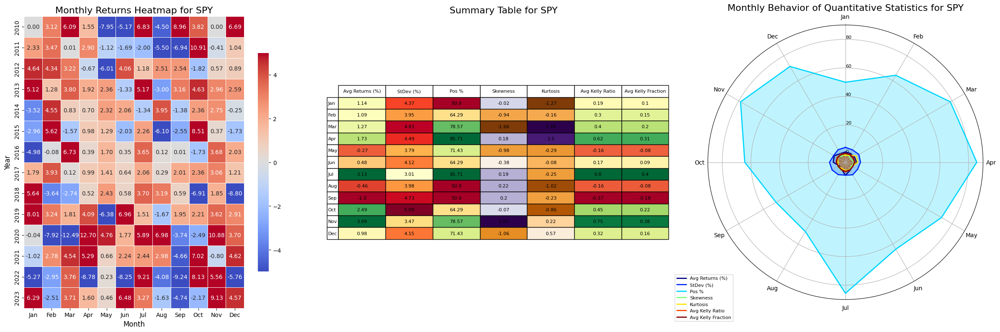

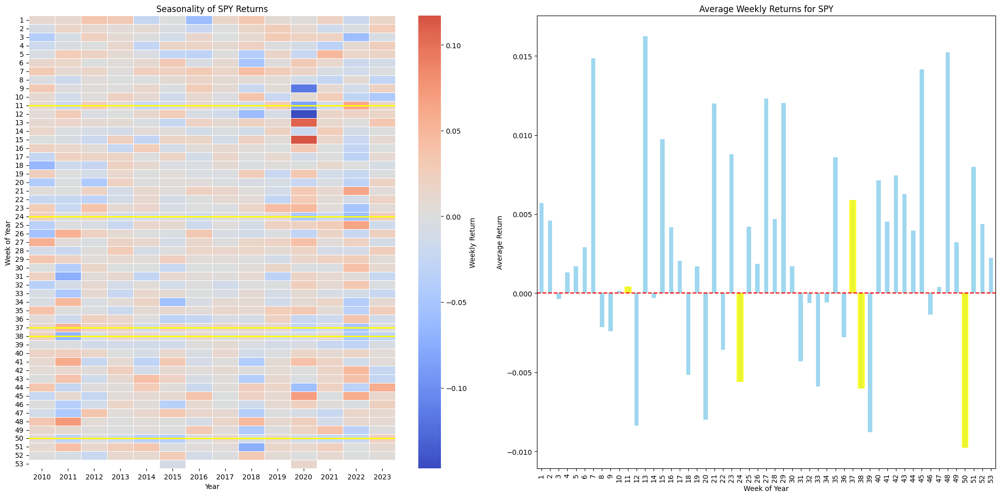

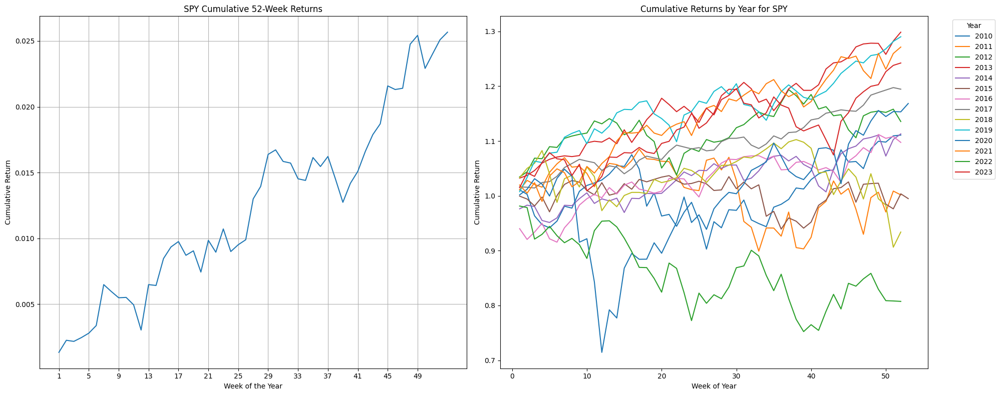

Analyzing QQQ


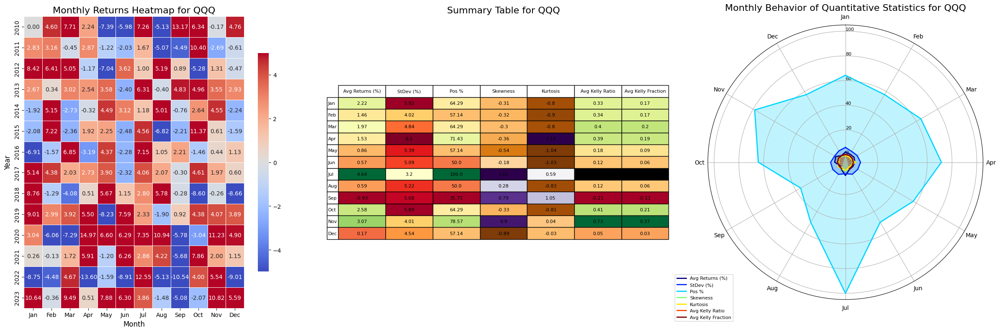

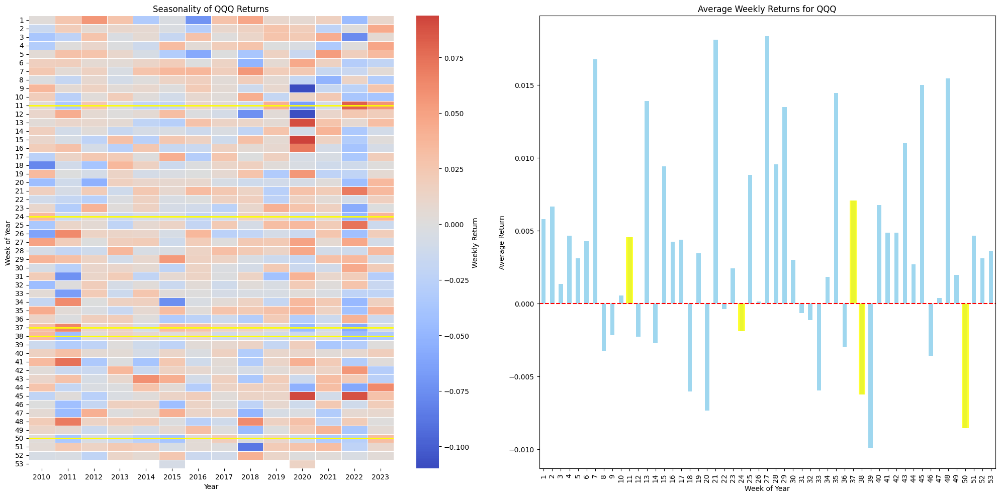

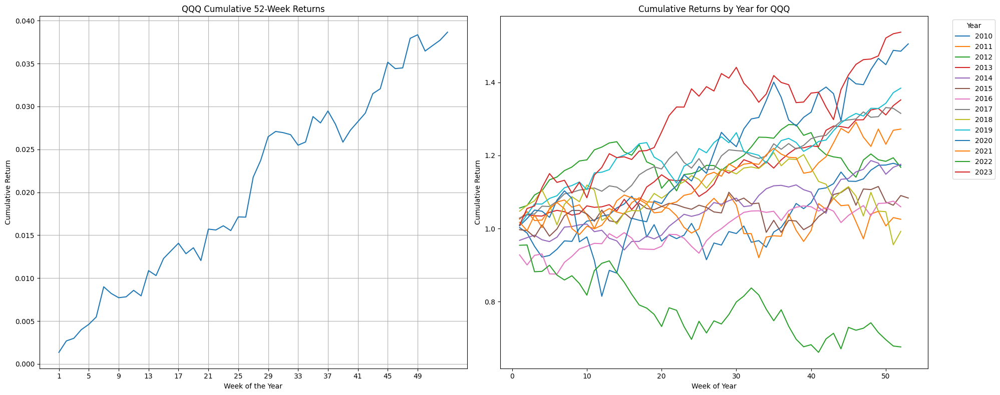

Analyzing QLC


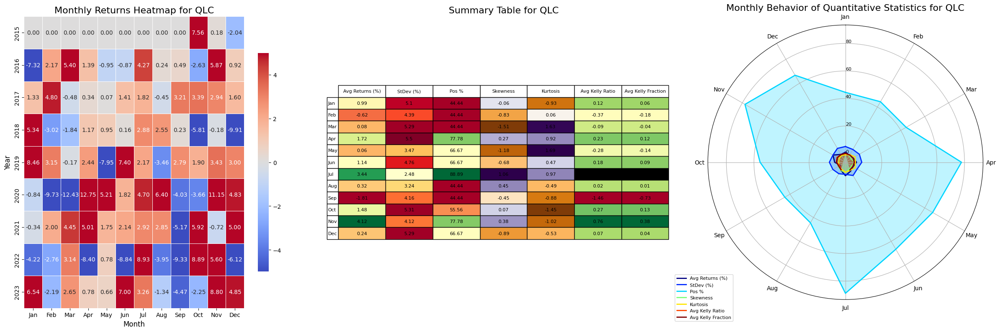

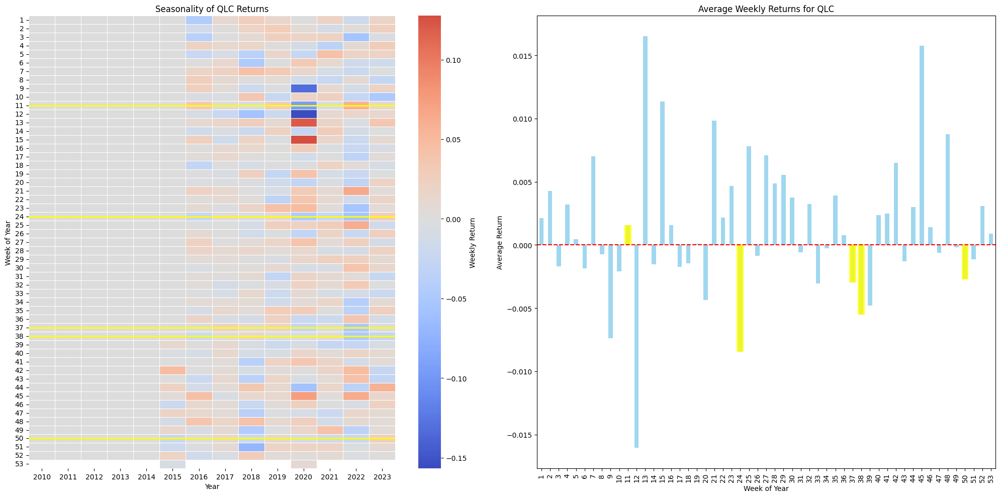

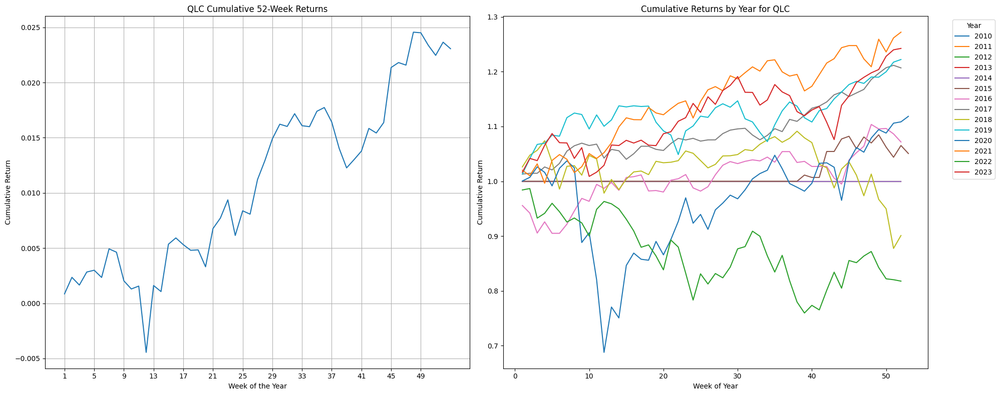

Analyzing IWM


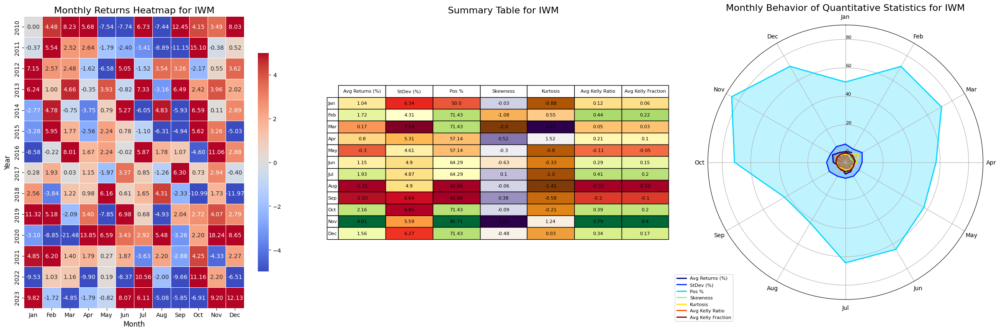

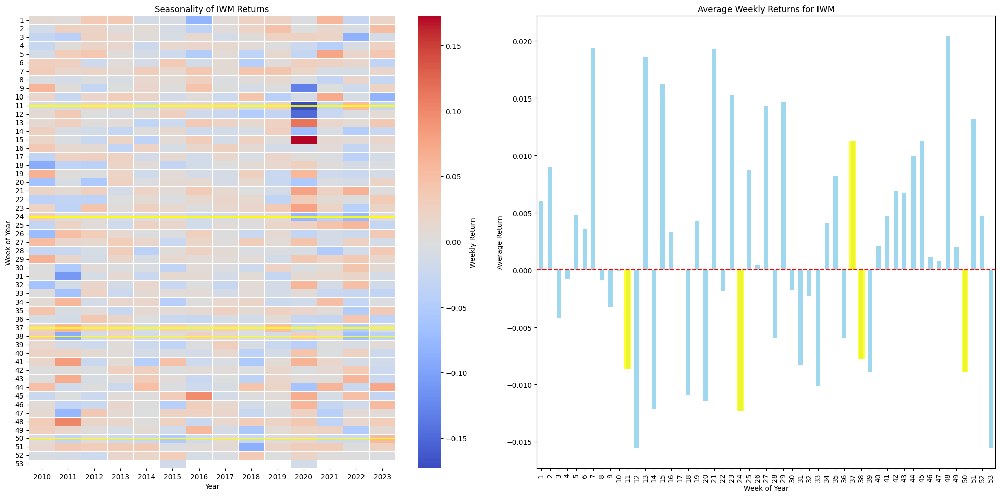

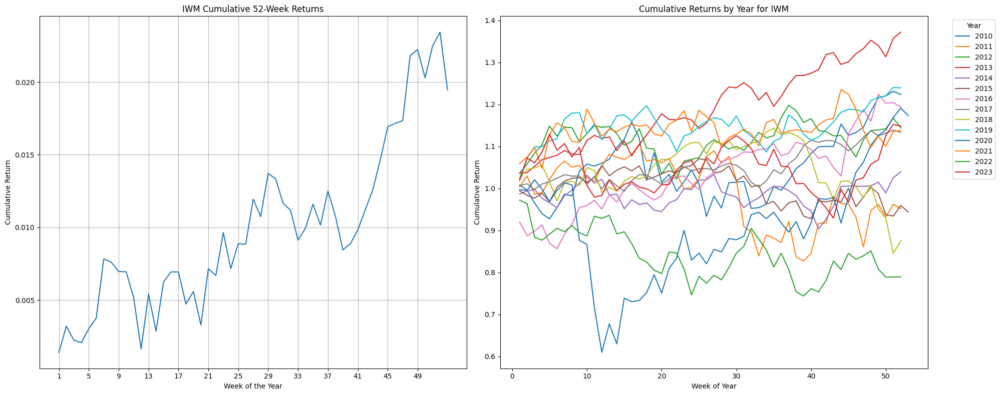

Analyzing DAX


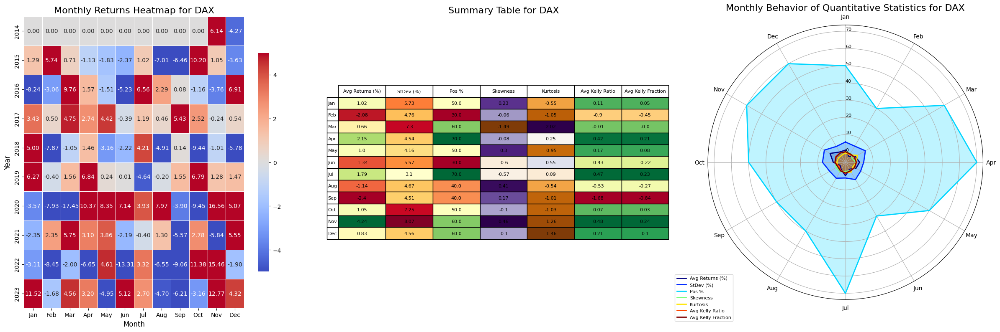

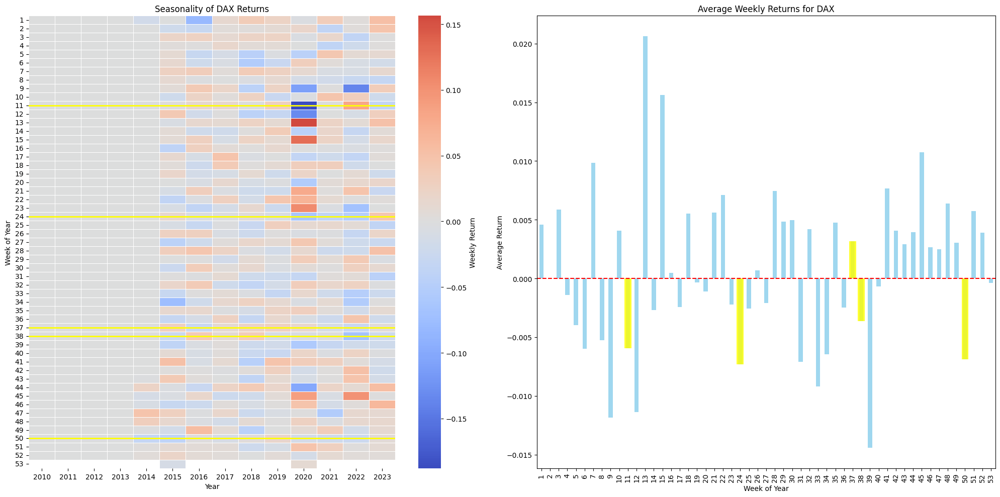

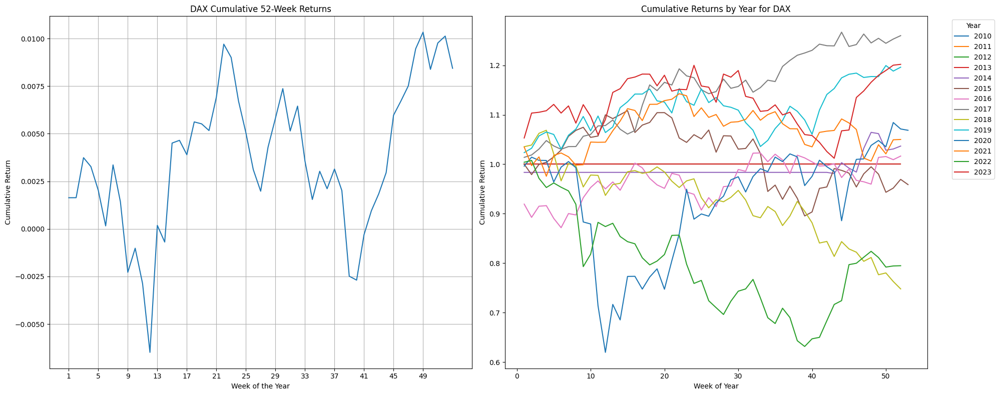

Analyzing XLK


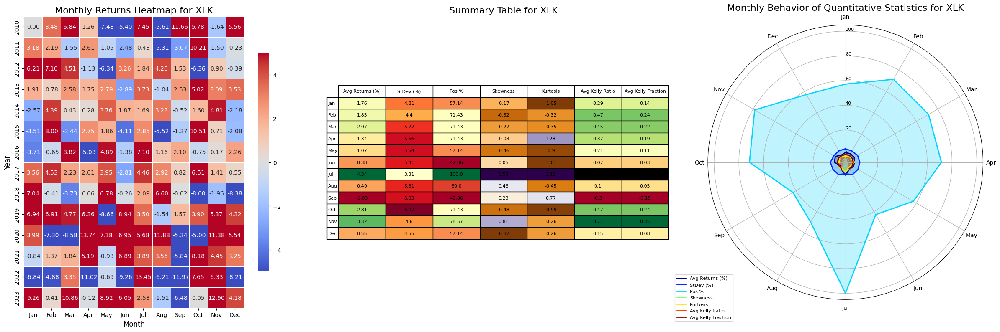

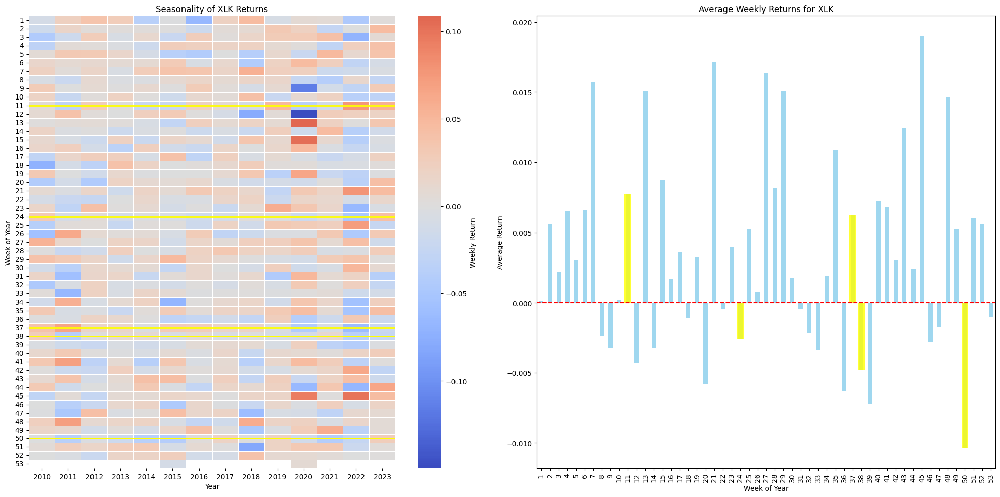

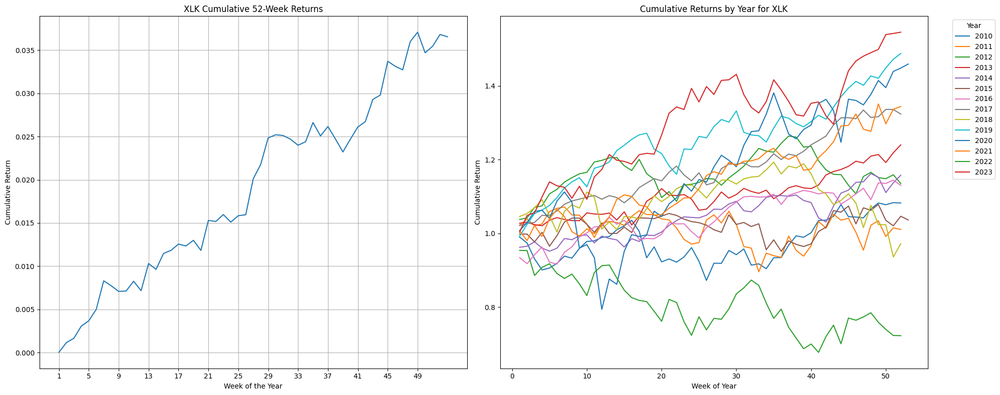

Analyzing XLF


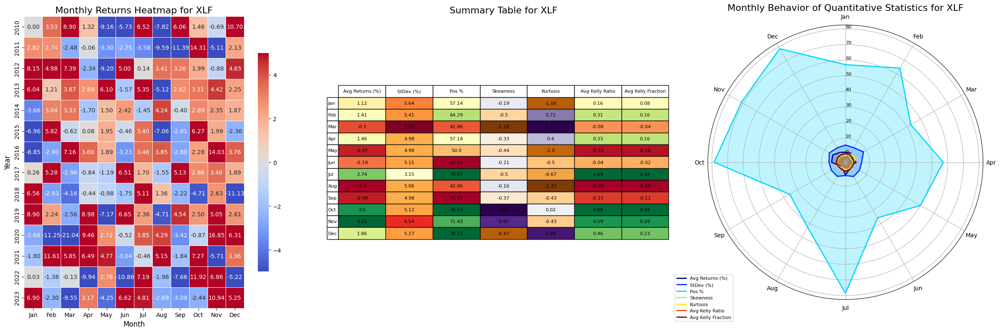

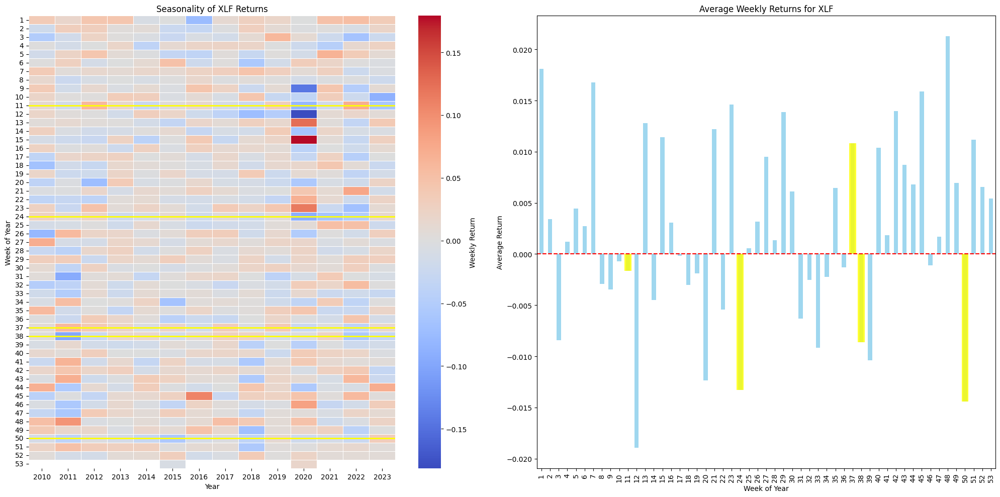

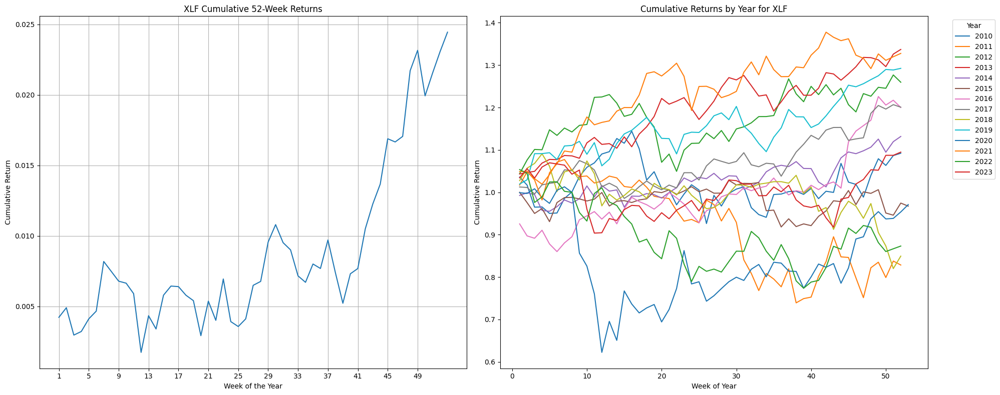

Analyzing XLV


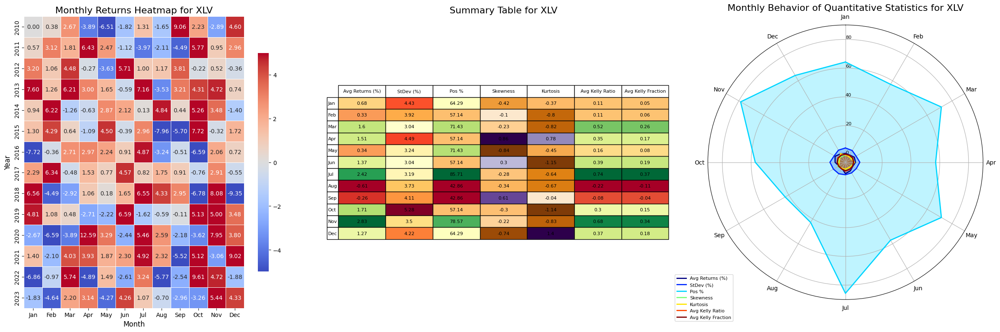

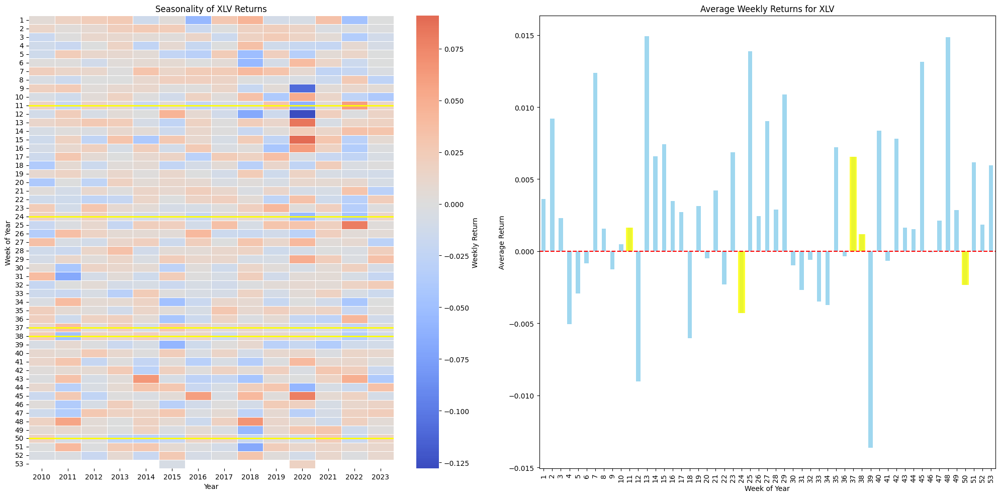

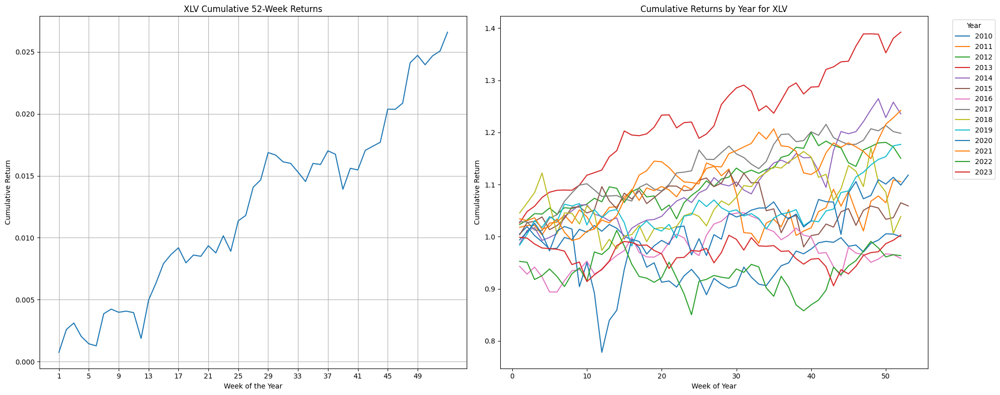

Analyzing XLE


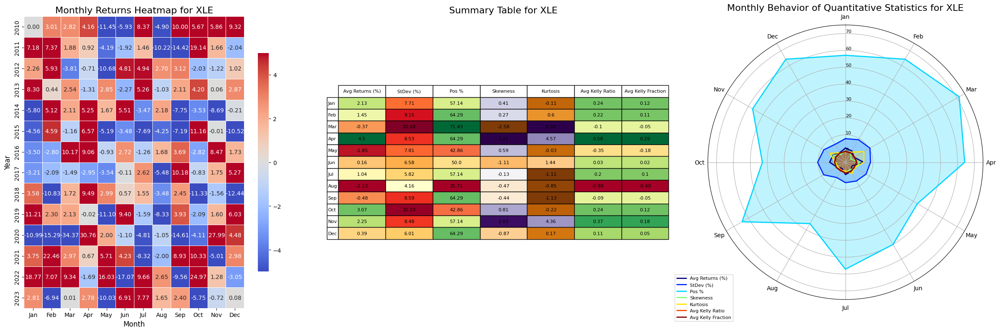

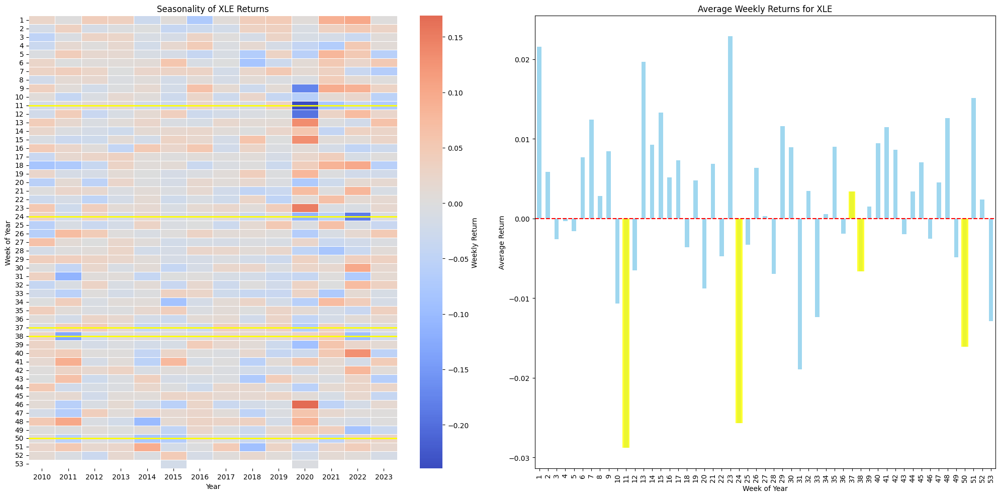

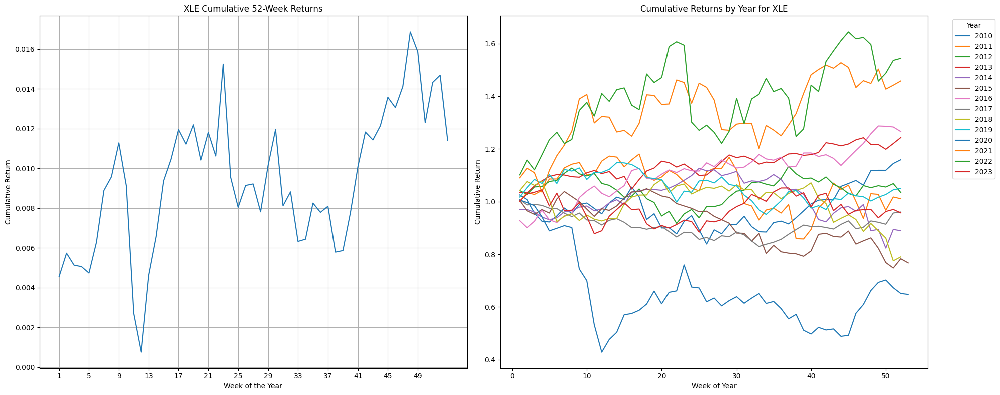

Analyzing XLY


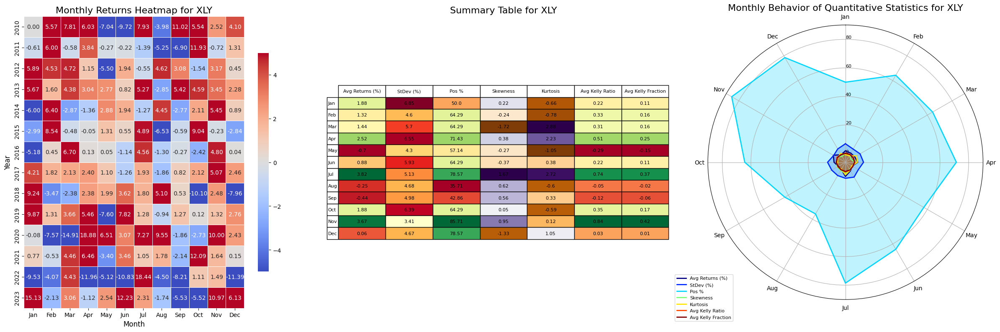

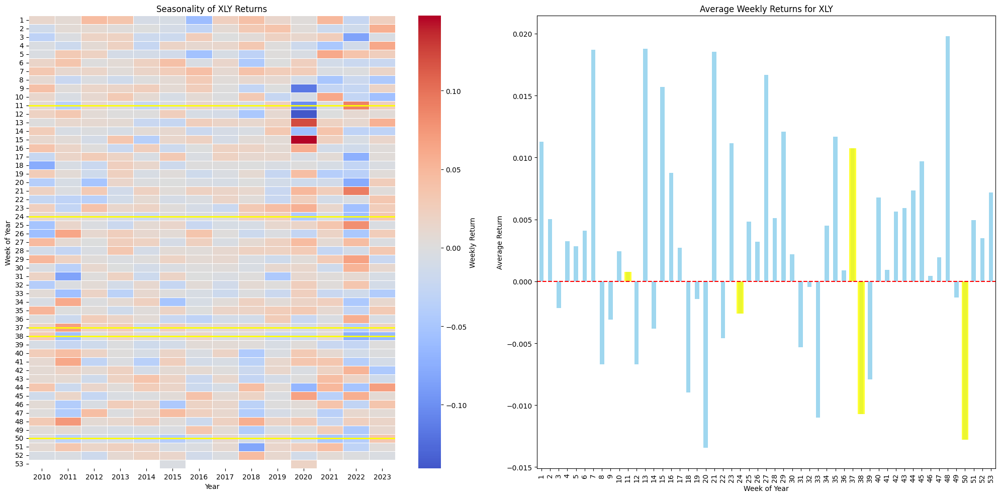

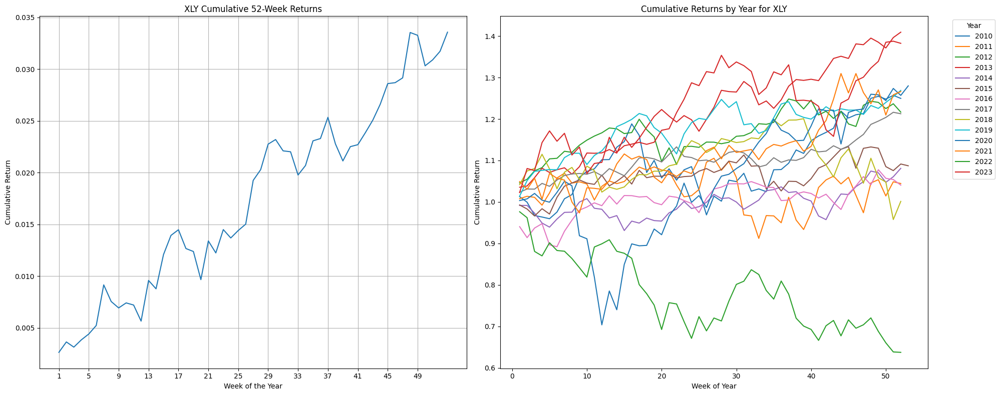

Analyzing XLP


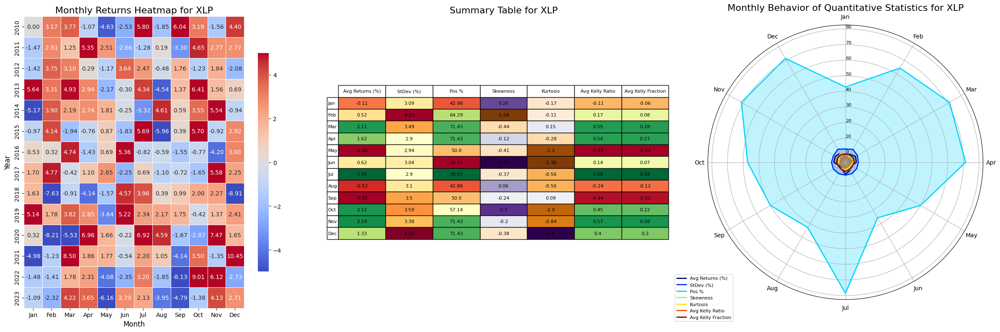

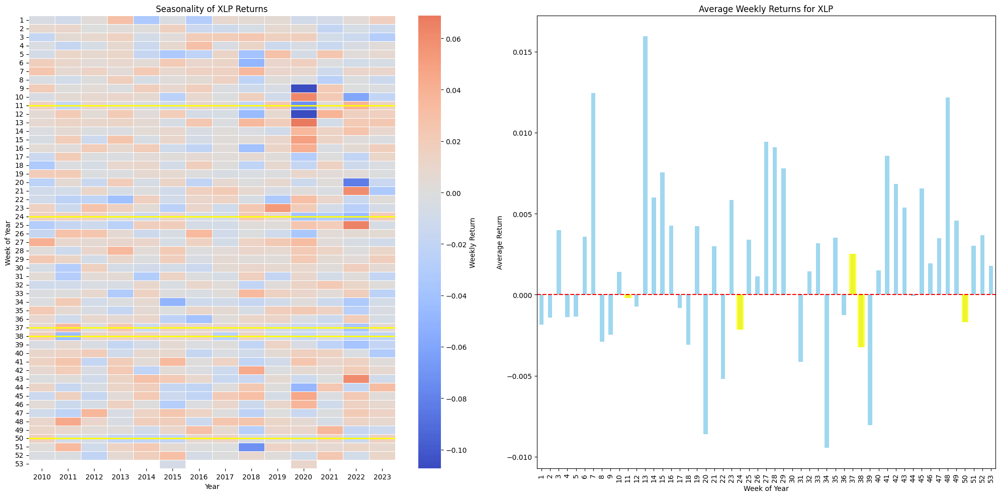

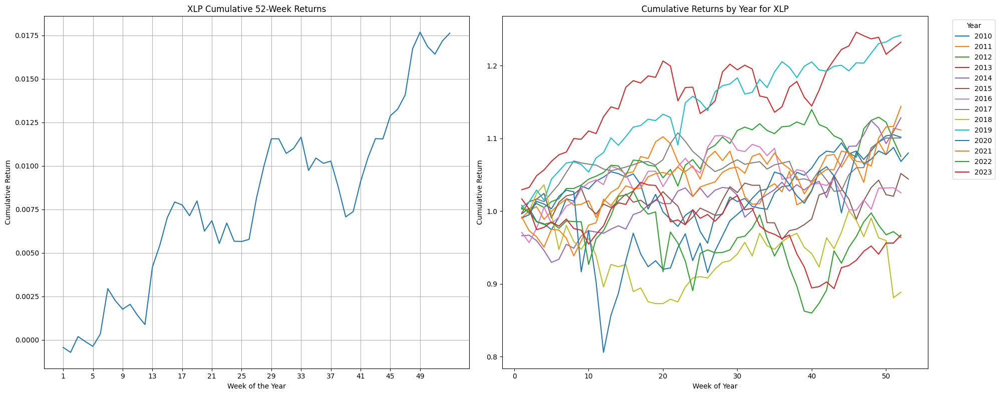

Analyzing XLI


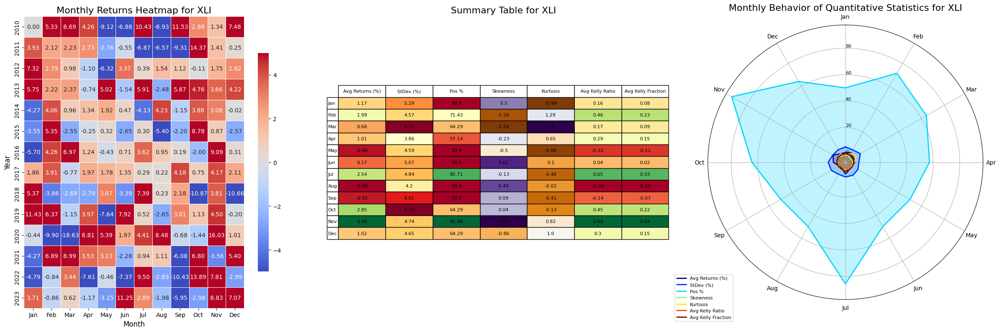

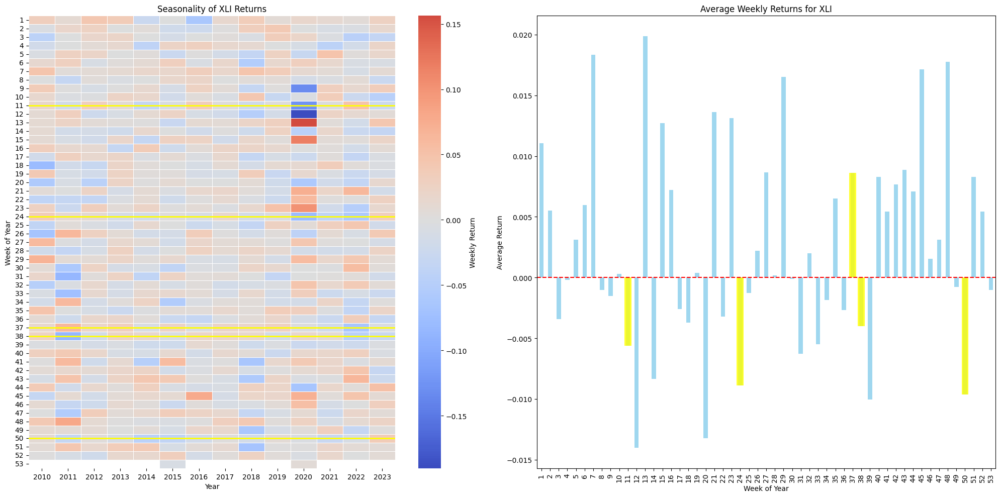

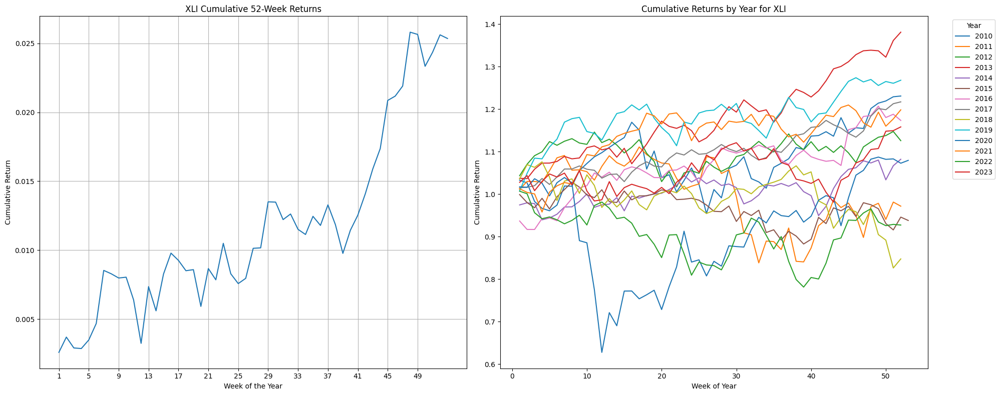

Analyzing XLU


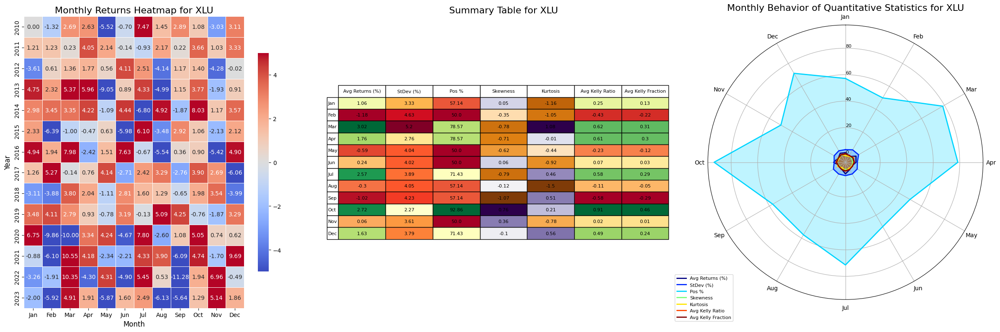

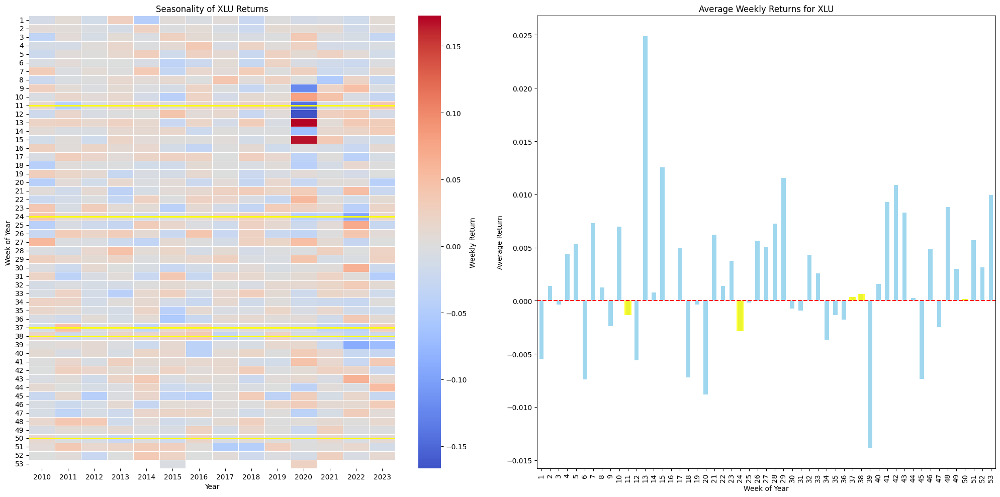

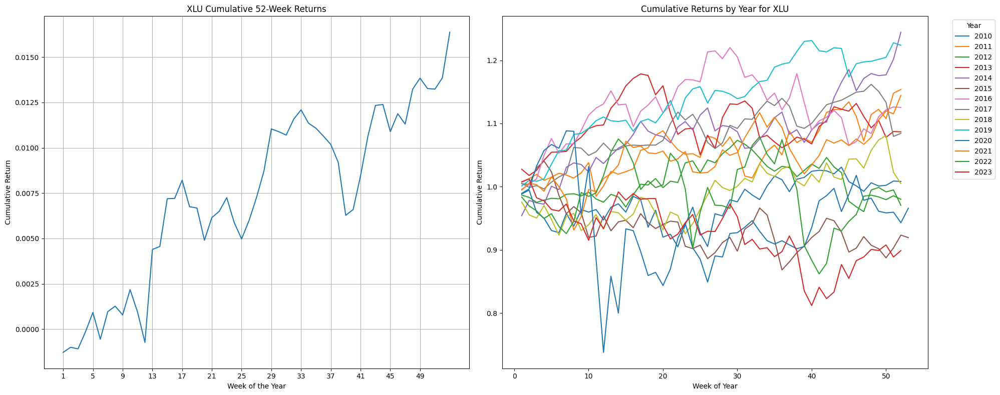

Analyzing XLB


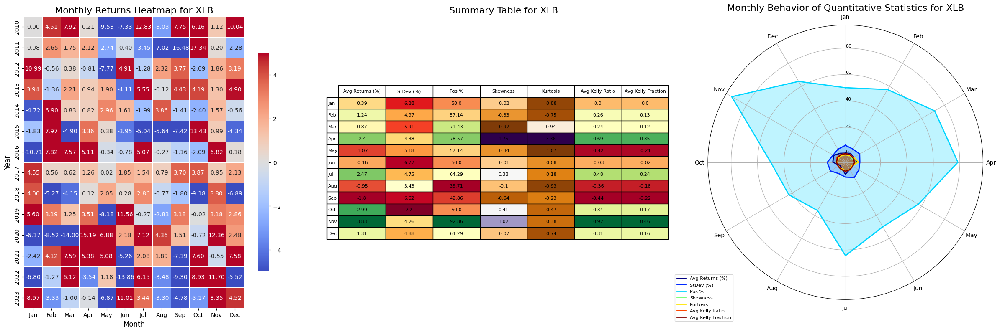

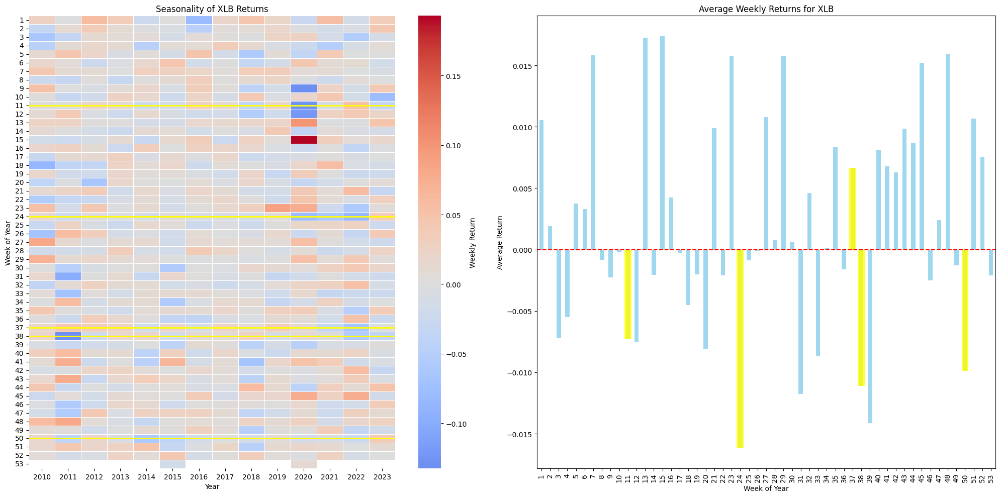

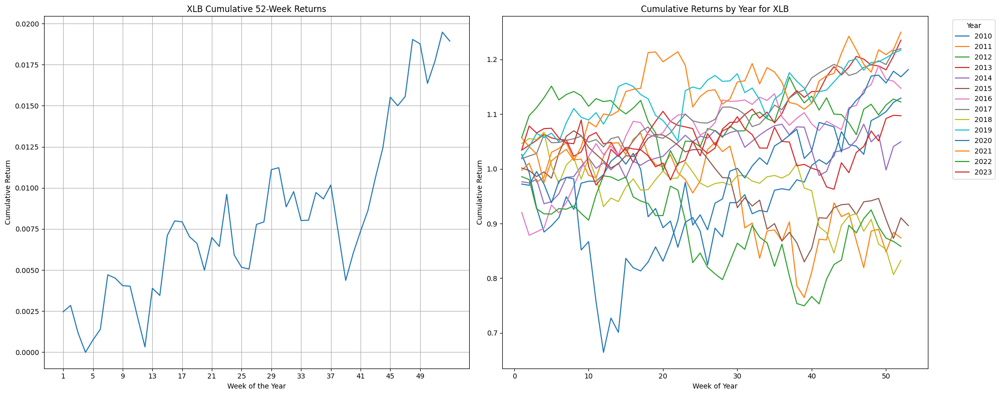

Analyzing XLRE


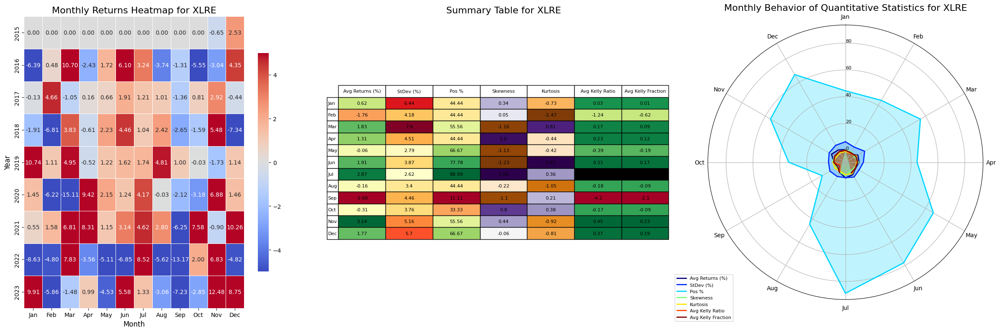

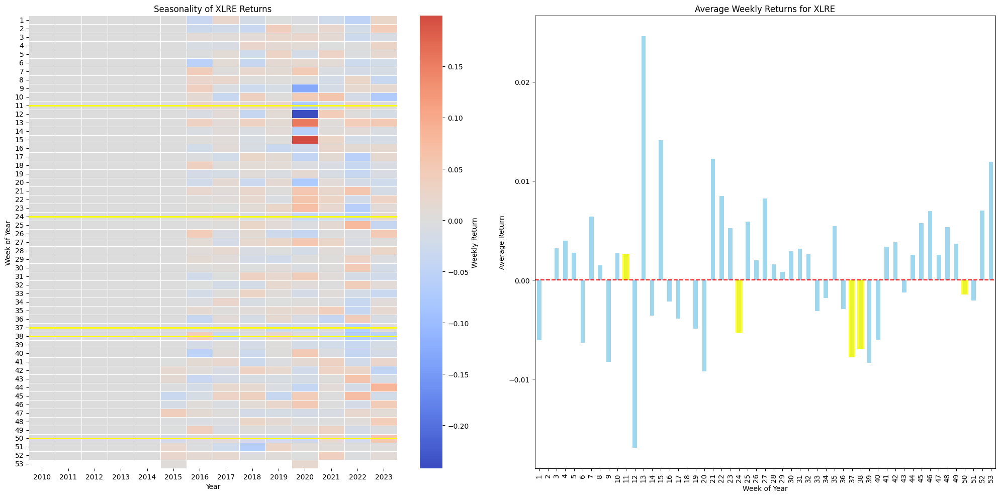

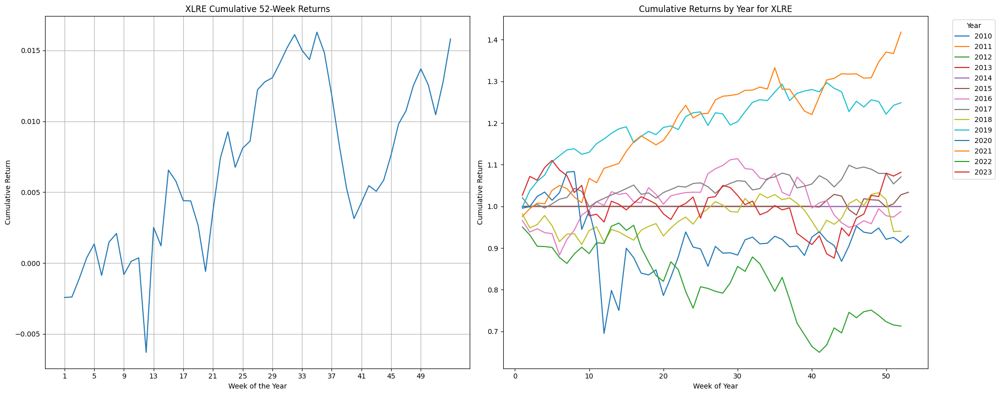

Analyzing XLC


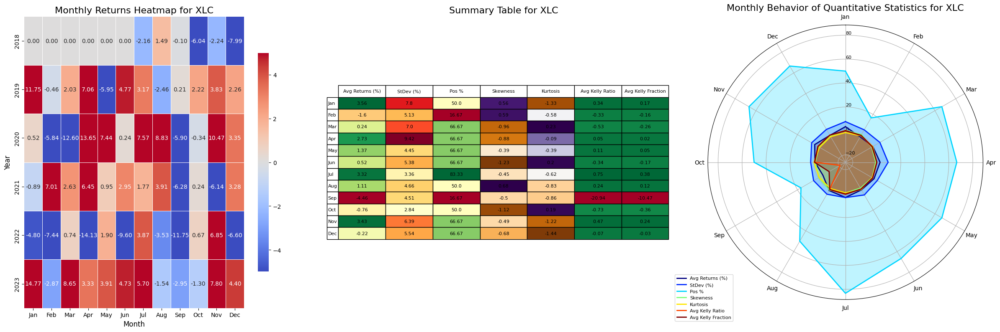

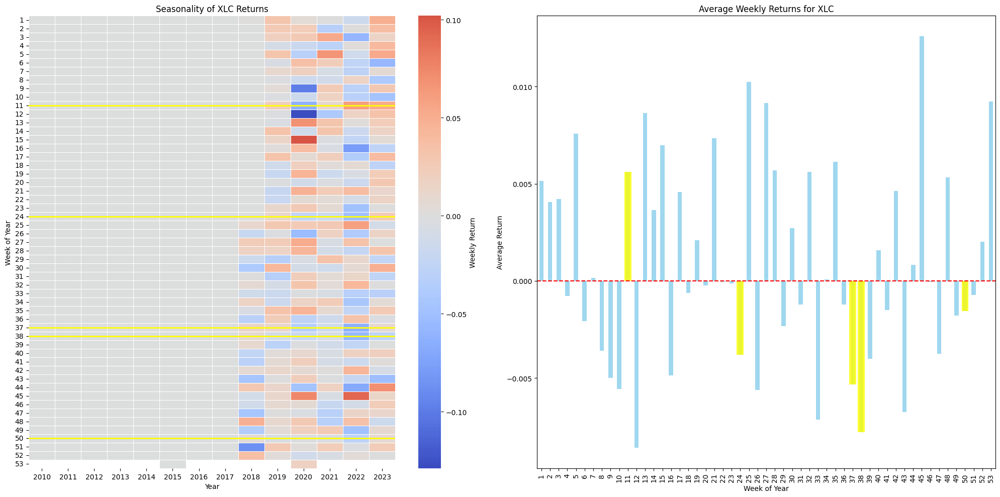

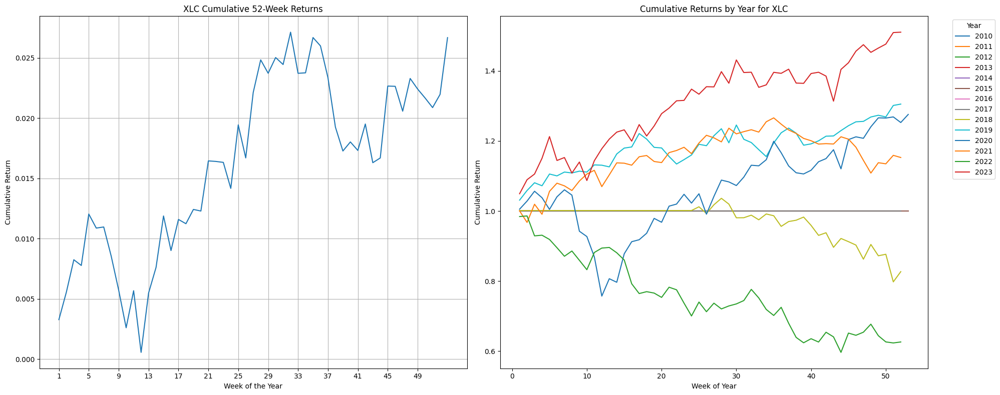

Analyzing TQQQ


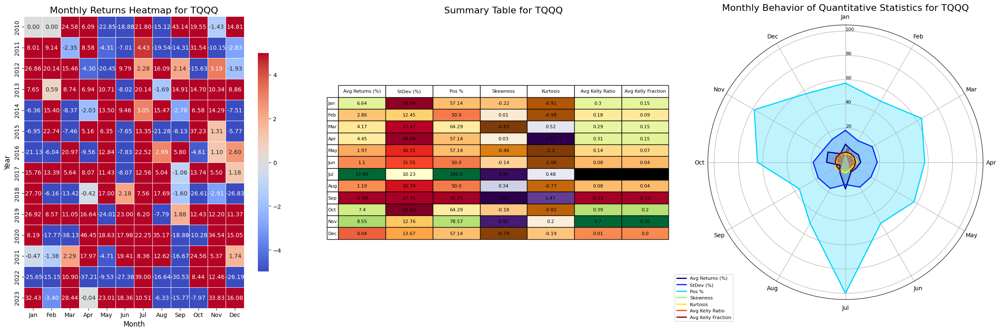

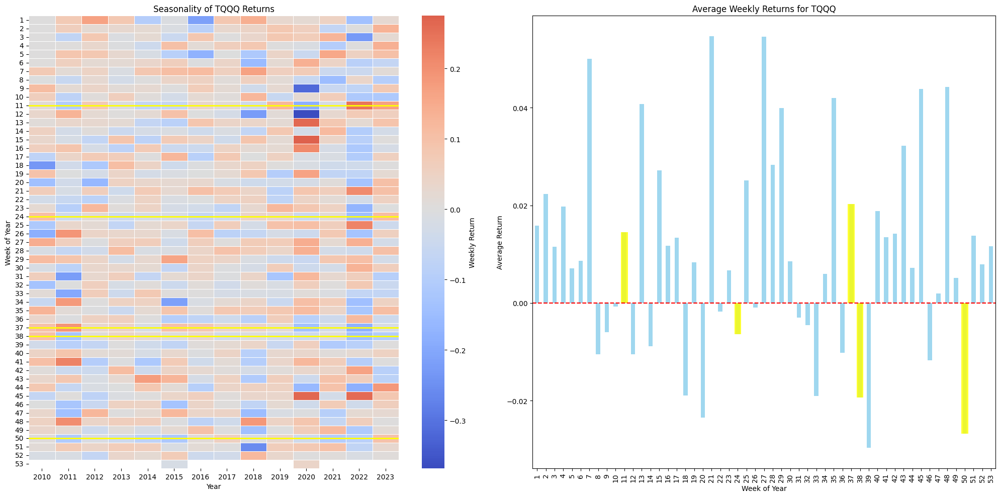

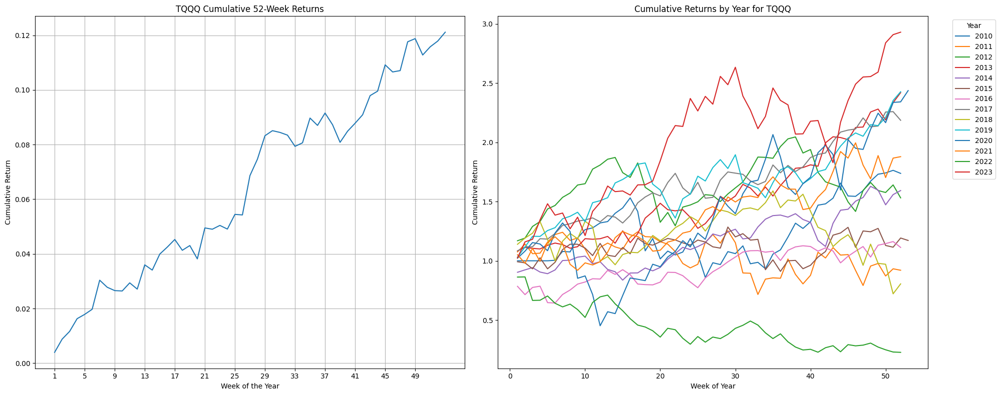

Analyzing UPRO


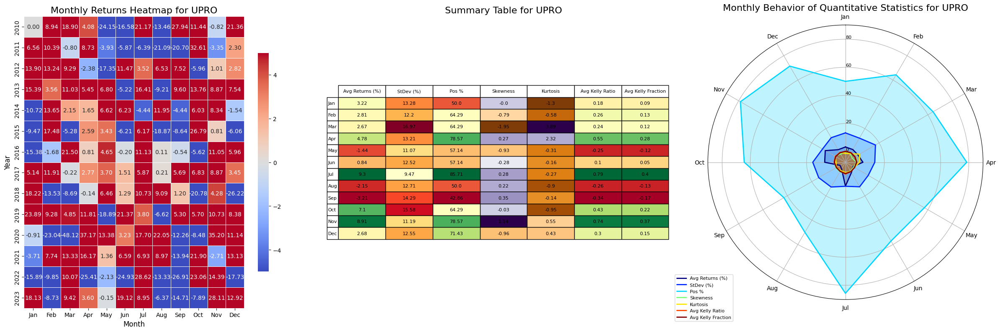

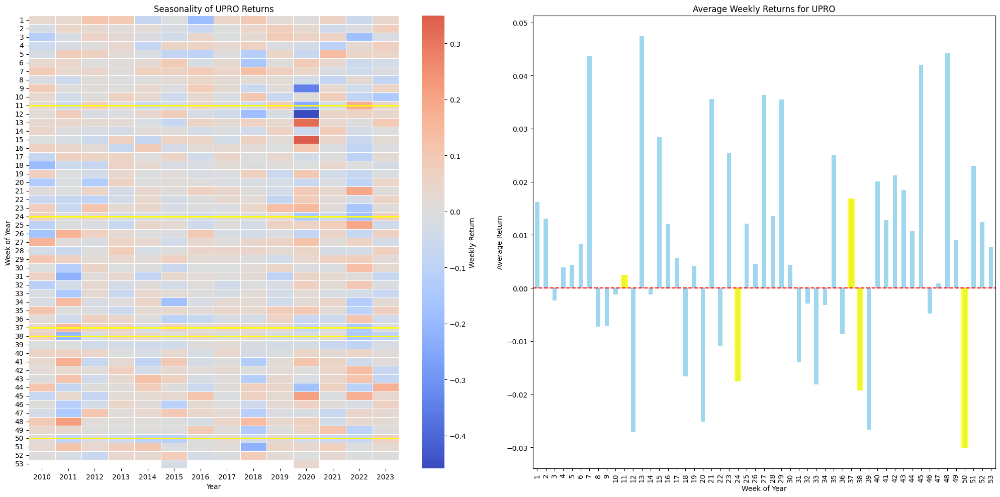

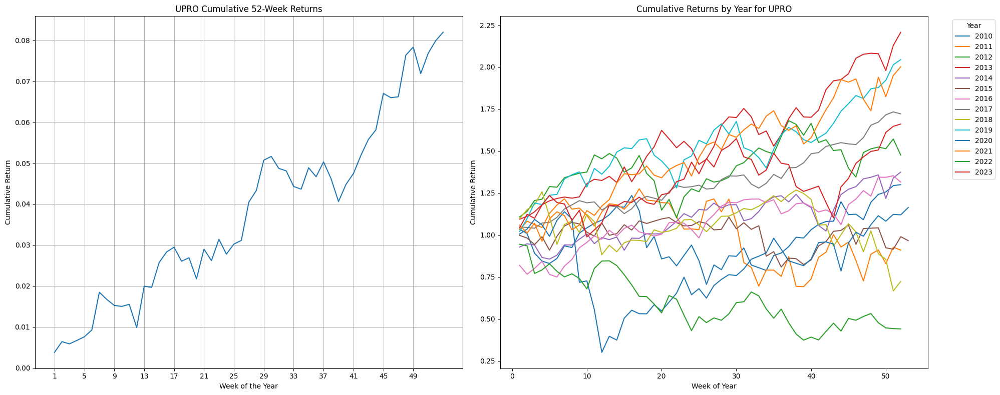

Analyzing TECL


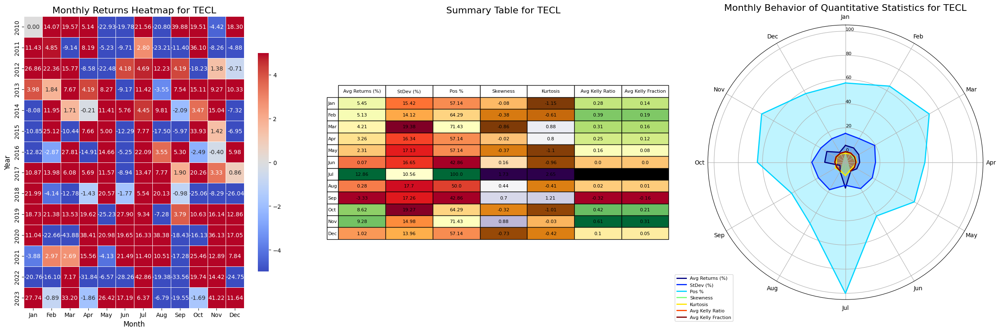

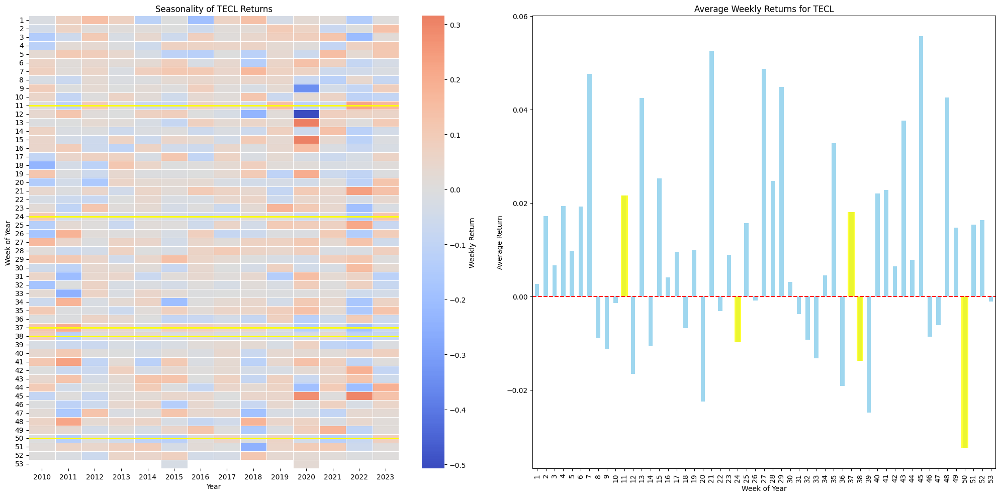

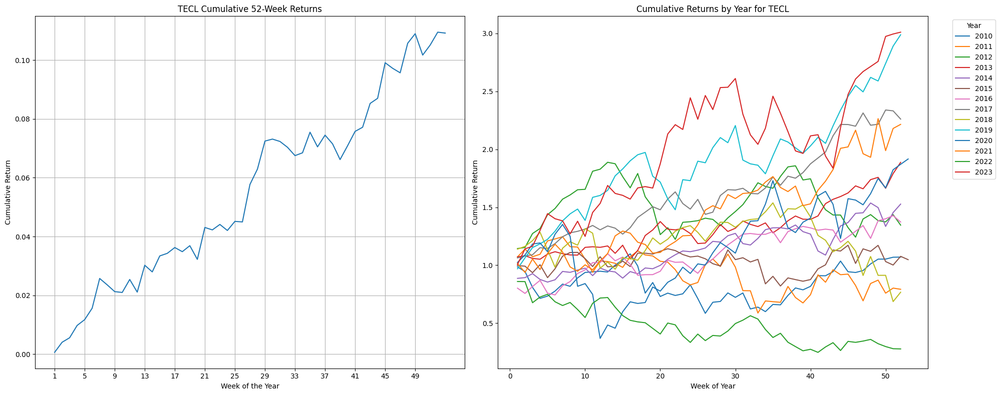

Analyzing TECS


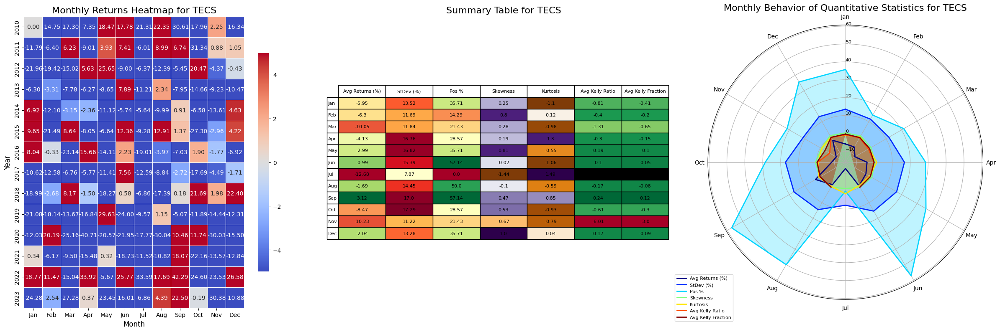

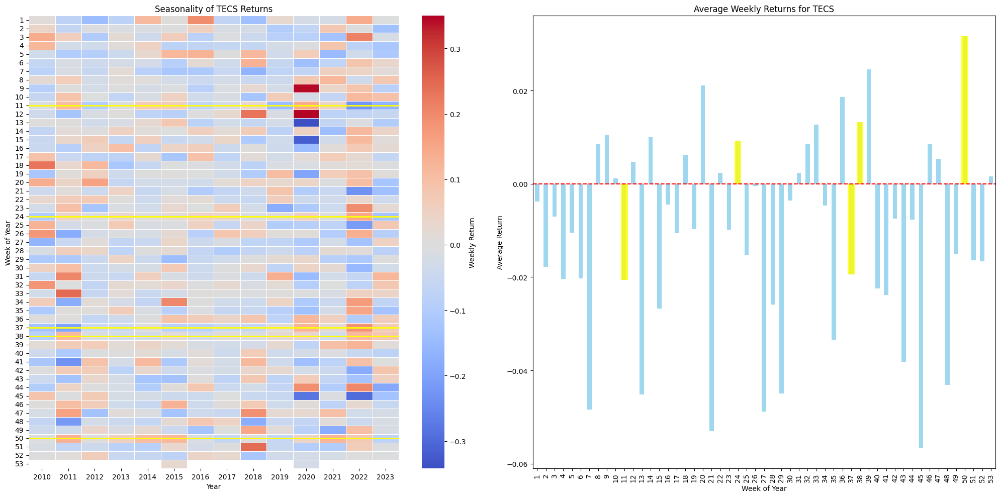

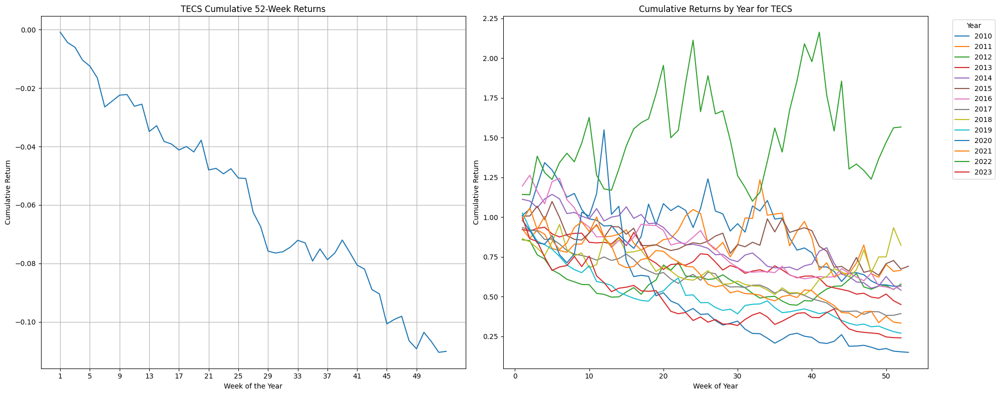

Analyzing FAS


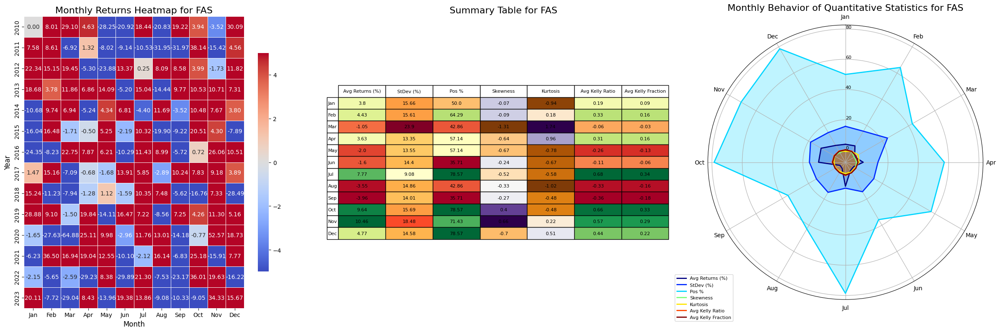

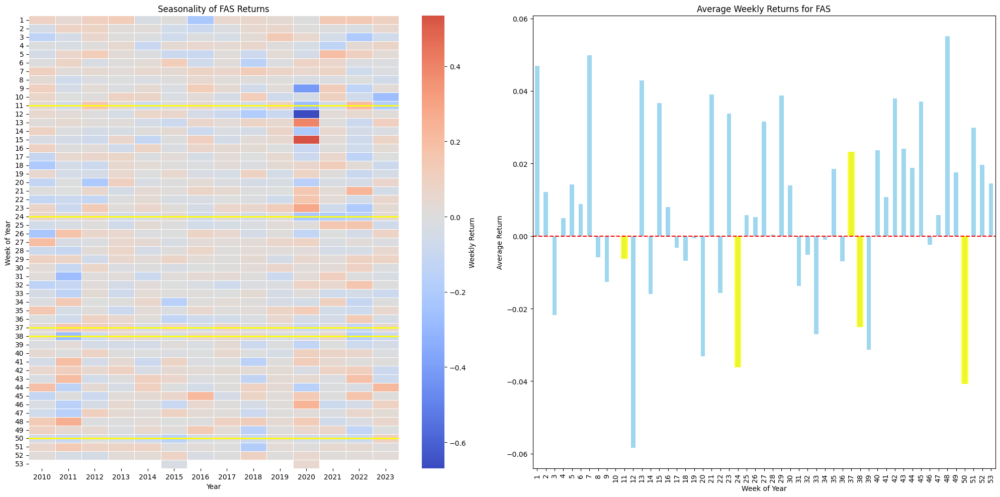

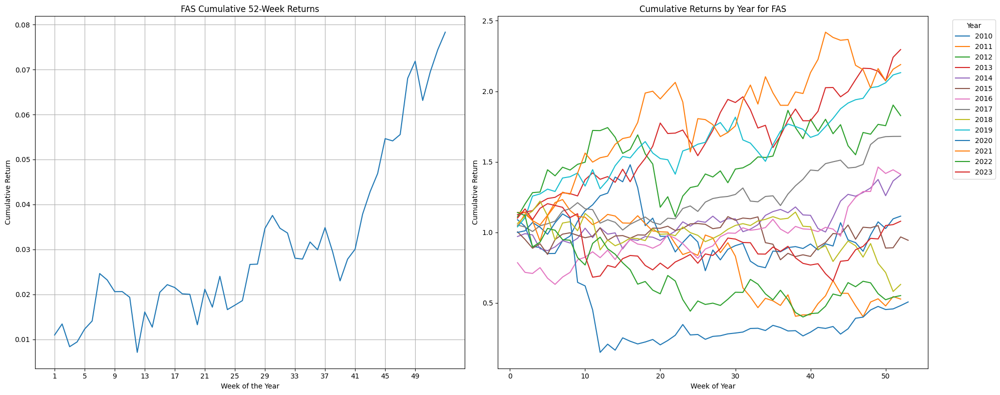

Analyzing FAZ


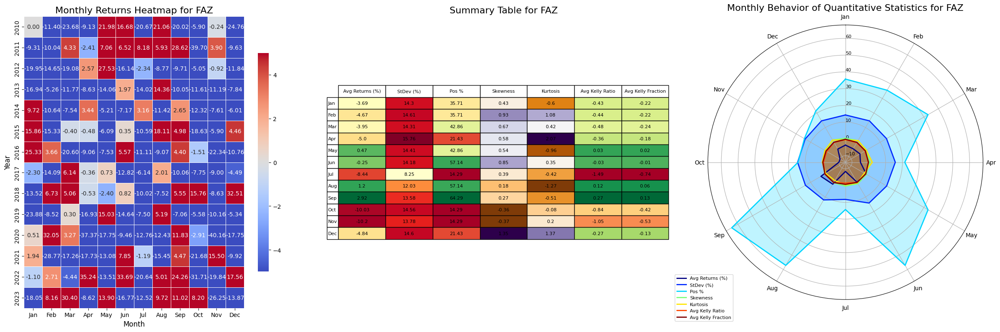

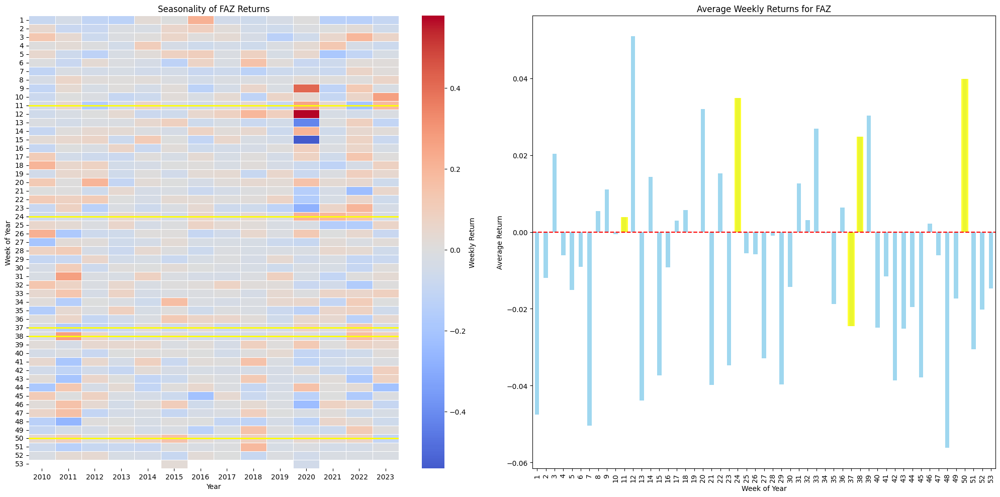

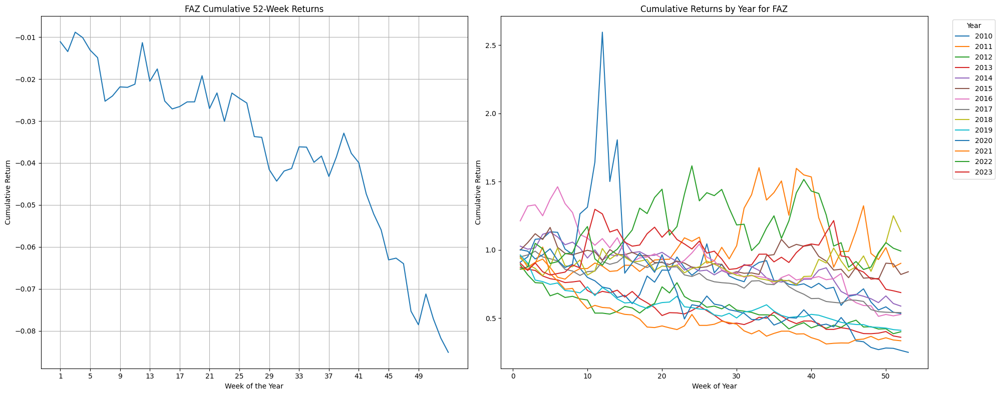

Analyzing ERX


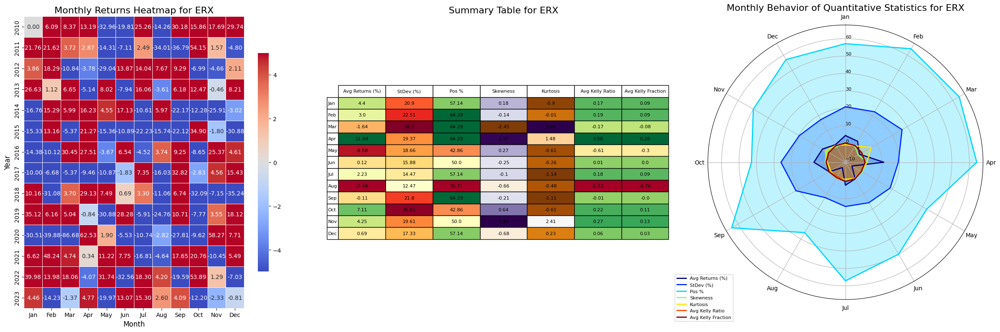

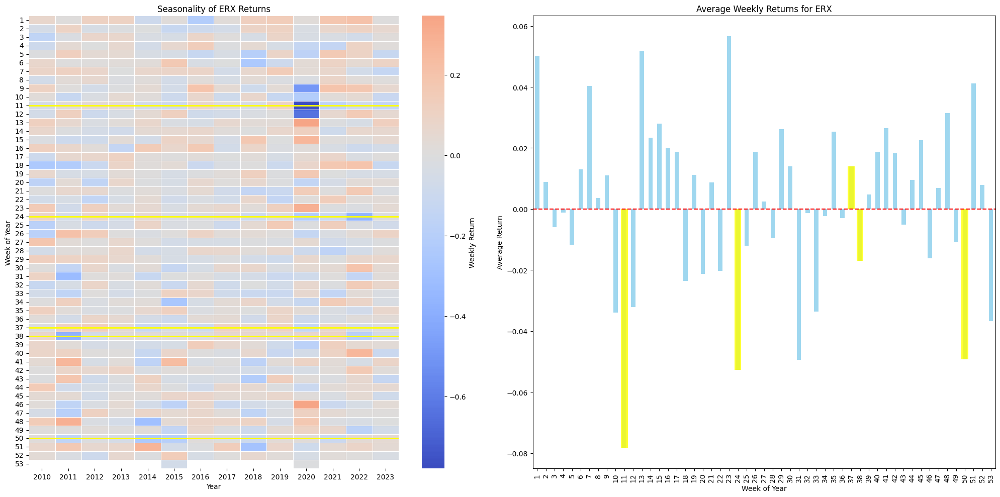

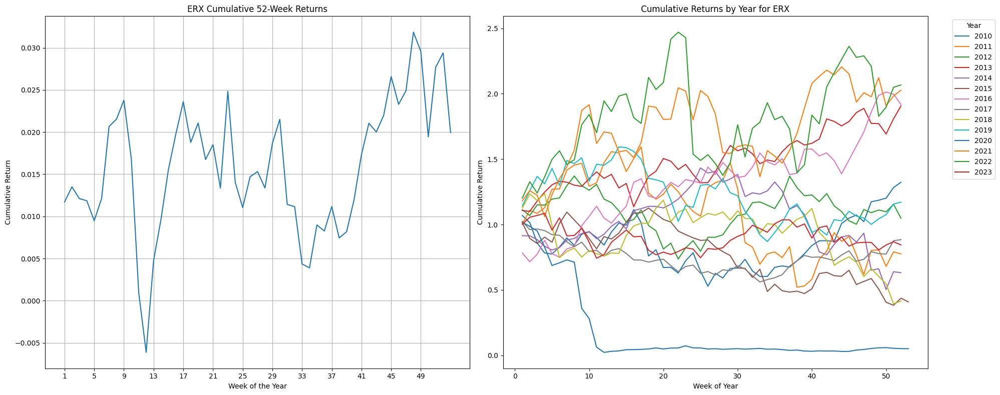

Analyzing ERY


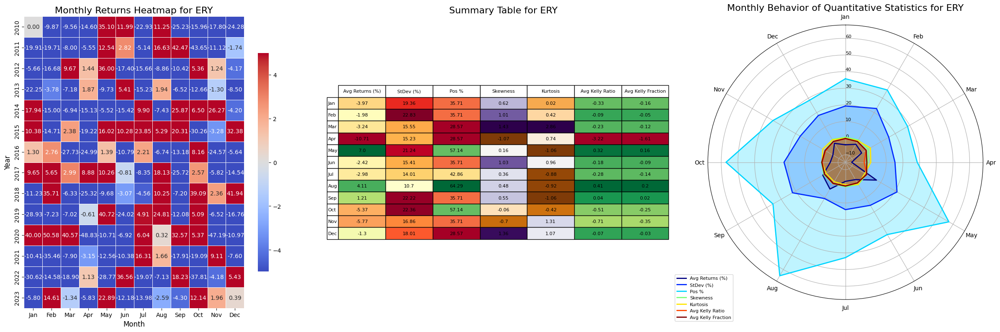

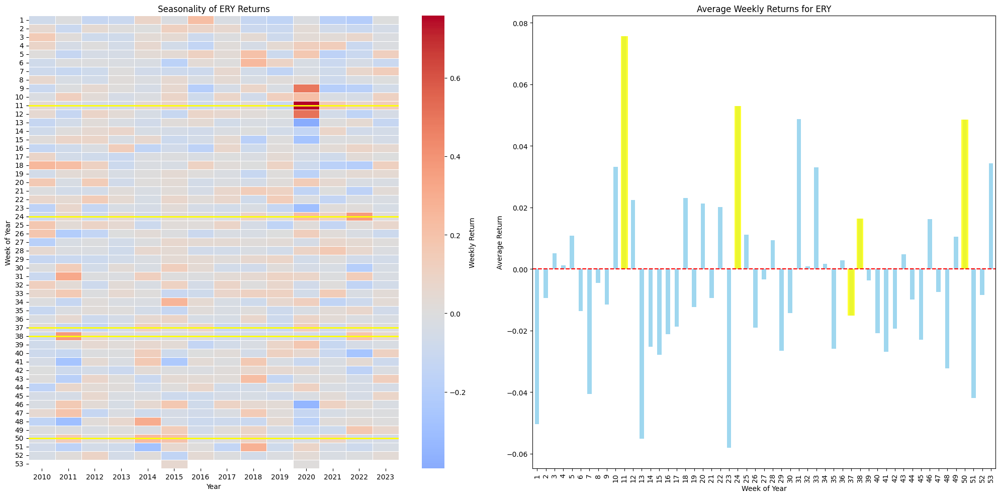

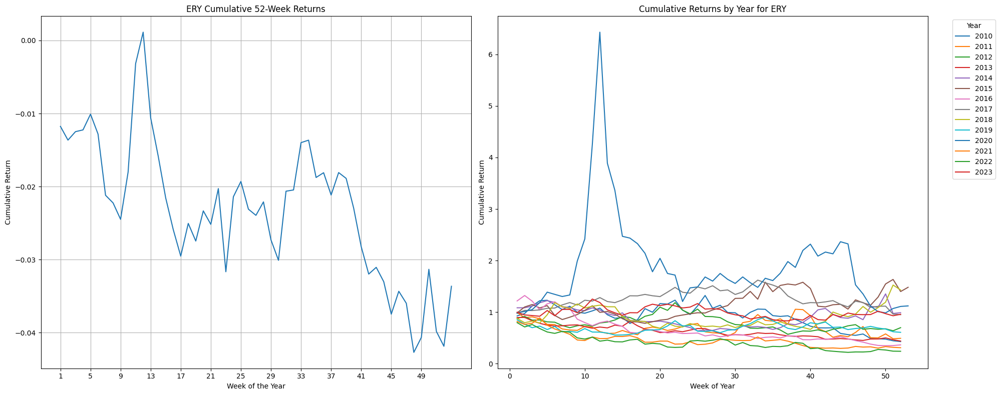

Analyzing SOXL


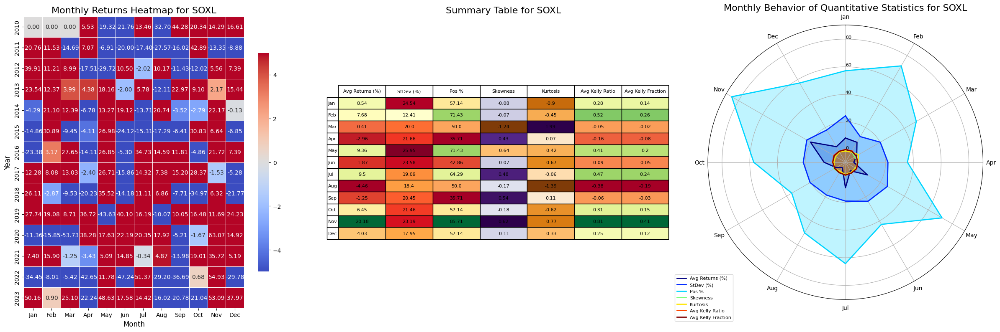

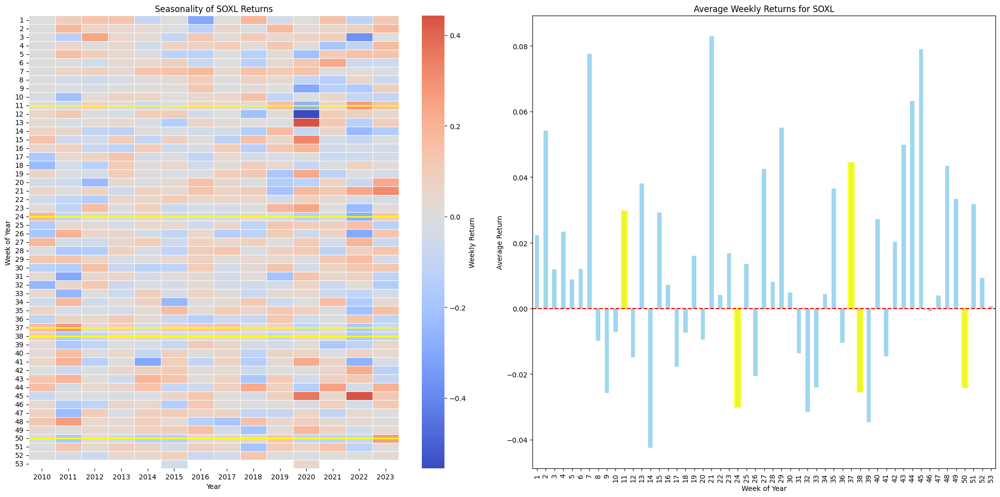

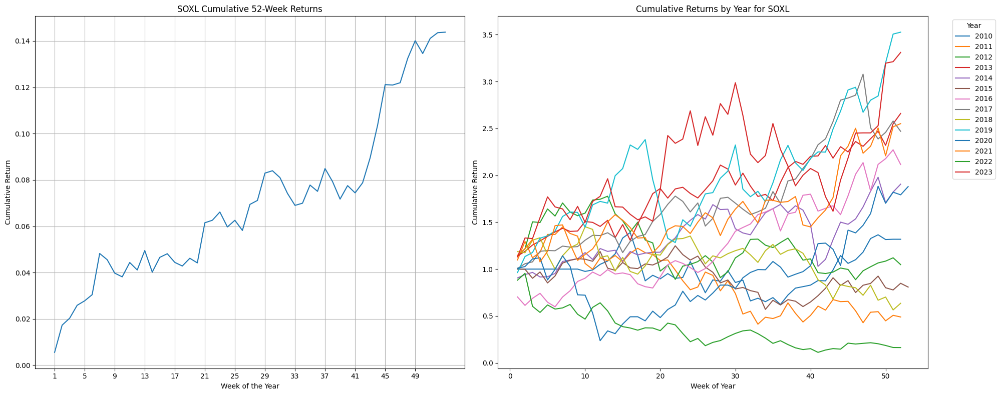

Analyzing SPXS


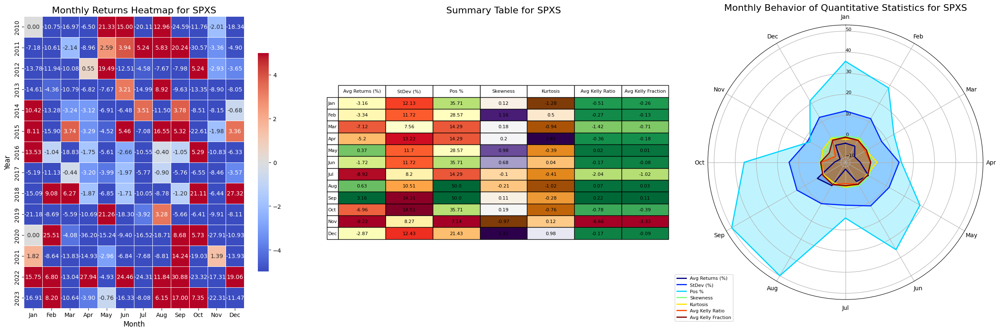

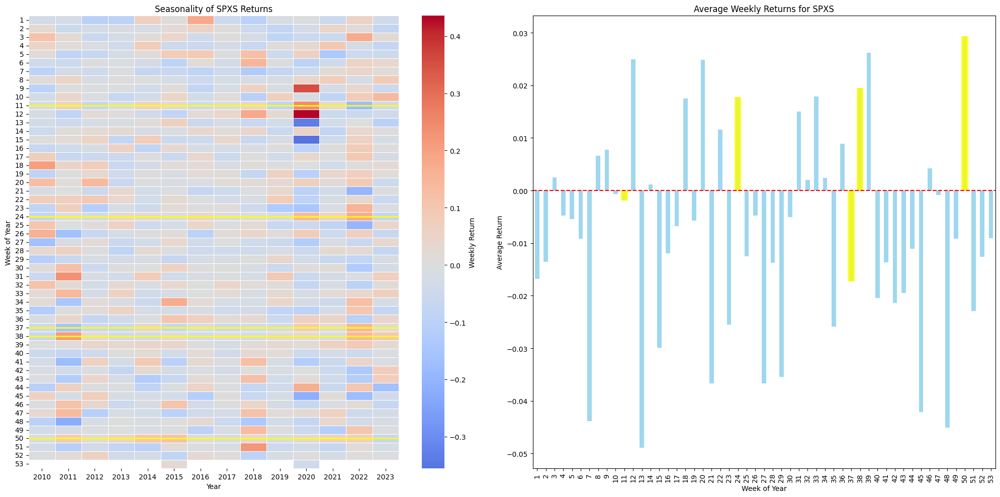

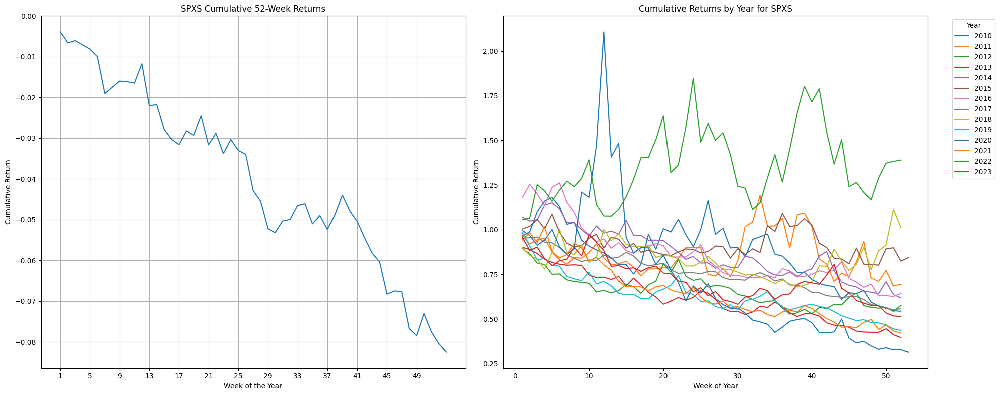

Analyzing VIX


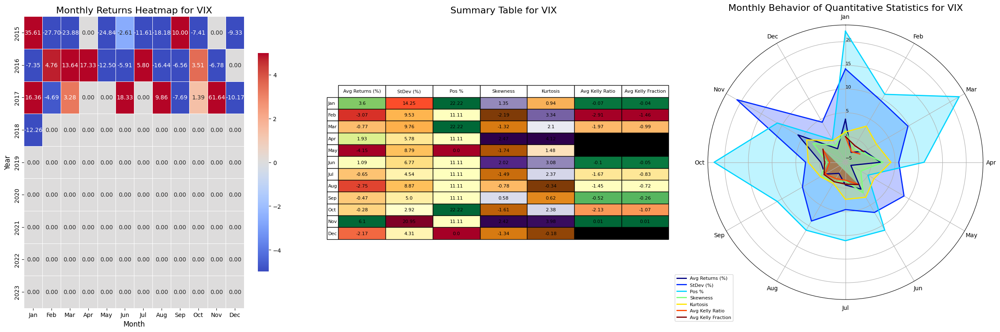

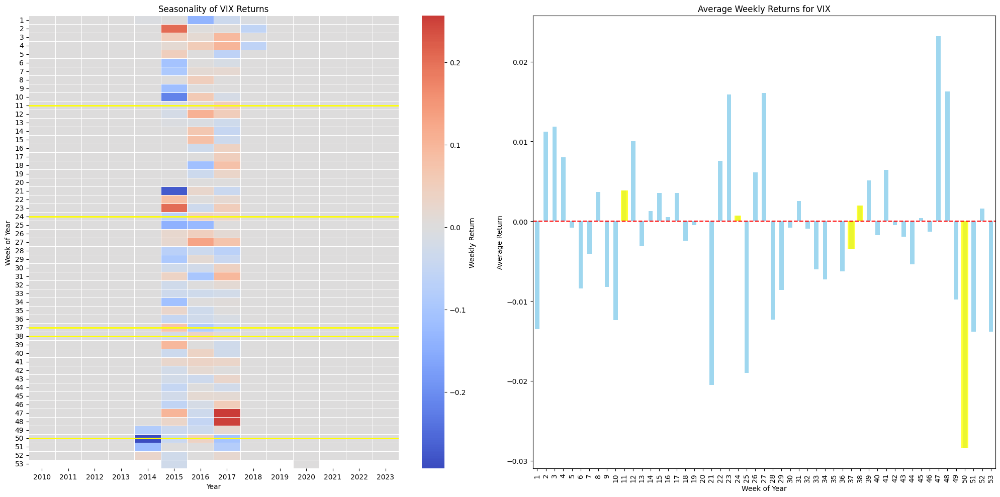

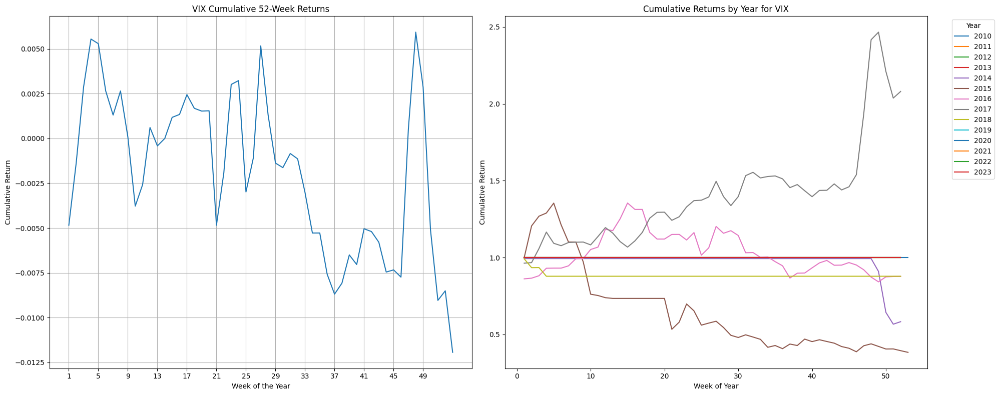

Analyzing UVXY


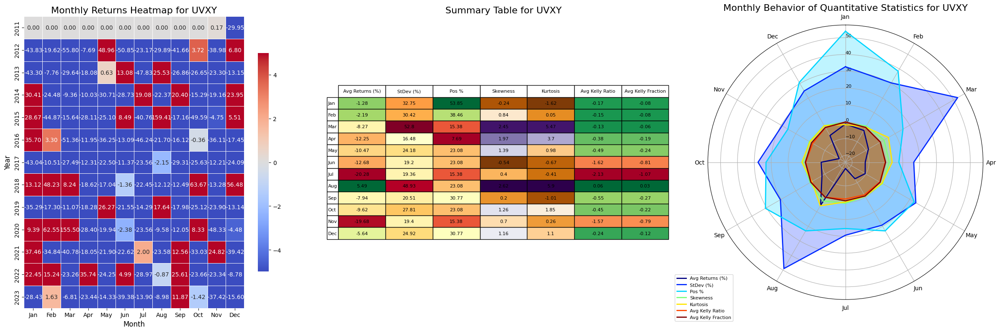

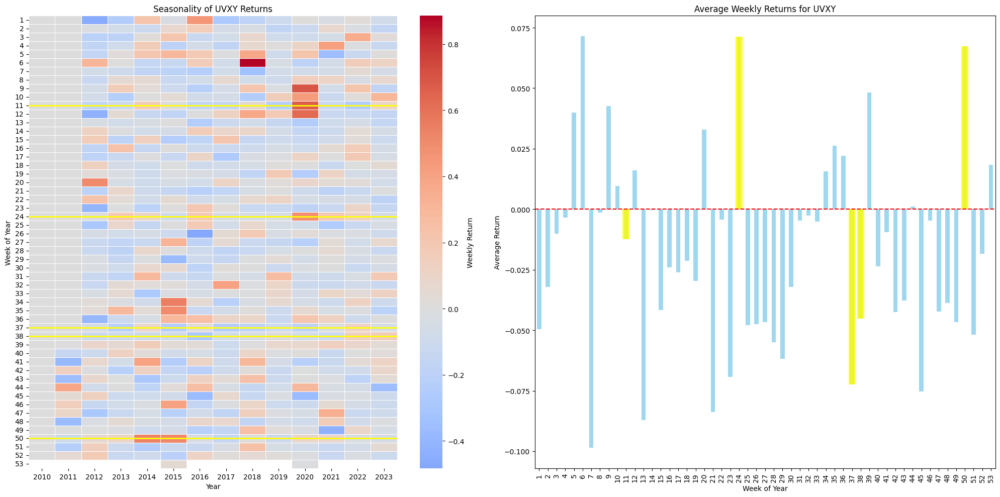

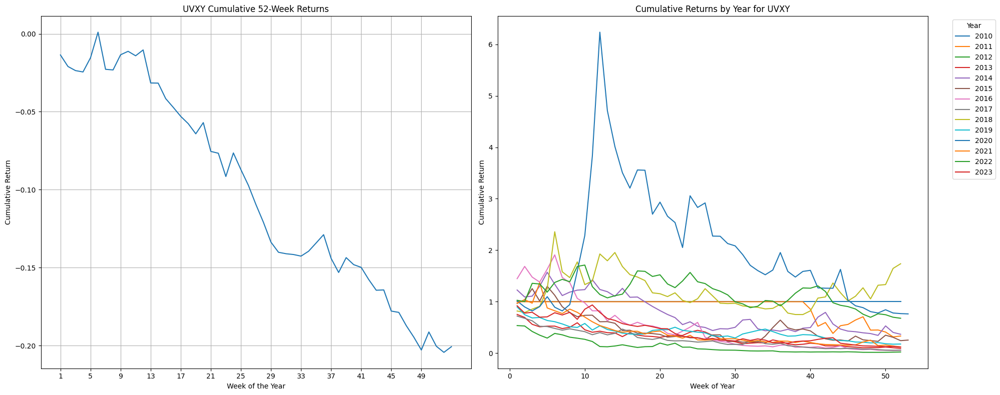

Analyzing SPYD


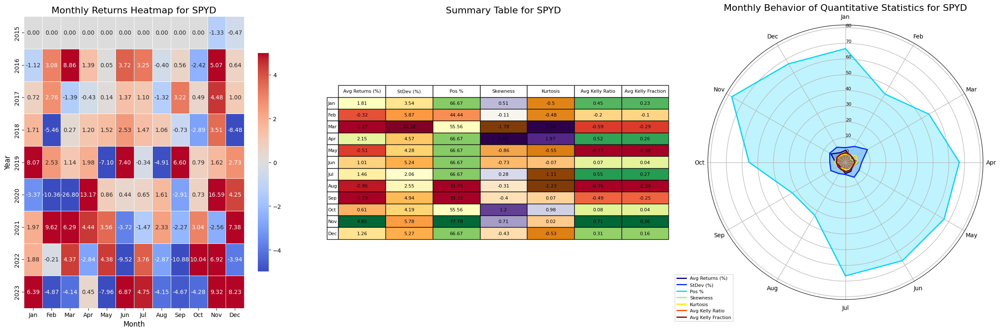

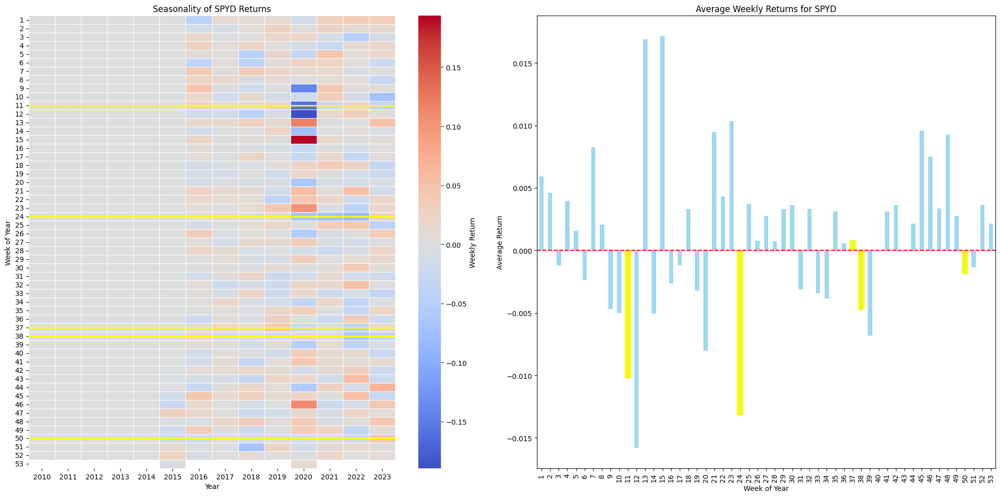

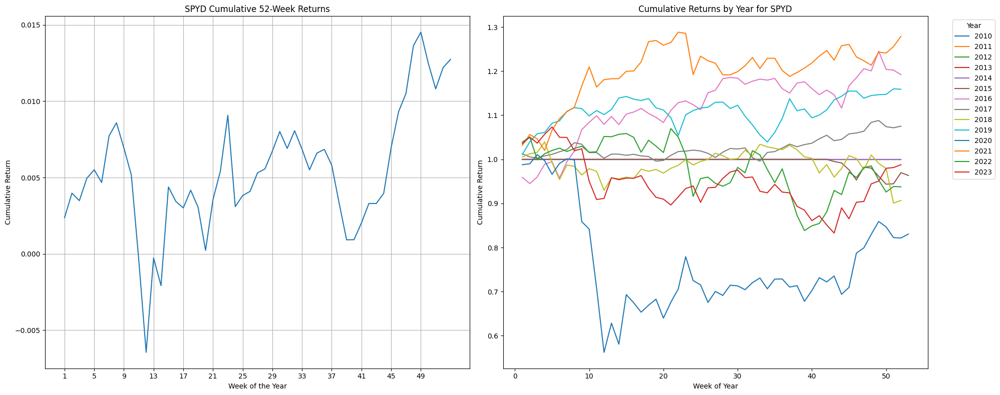

Analyzing SPYI


KeyError: 0

In [10]:
class SeasonalityAnalyzer:
    def __init__(self, tickers, start_date='1990-01-01', end_date=None, triple_witching_weeks=None, odds_ratio=2, output_dir='seasonality_data'):
        self.tickers = tickers if isinstance(tickers, list) else [tickers]
        self.start_date = start_date
        self.end_date = end_date if end_date else datetime.now().strftime('%Y-%m-%d')
        self.triple_witching_weeks = triple_witching_weeks or []
        self.odds_ratio = odds_ratio
        self.output_dir = output_dir
        self.data = None

    def fetch_data(self):
        self.data = yf.download(self.tickers, start=self.start_date, end=self.end_date, group_by='ticker')

    def analyze_monthly_seasonality(self, ticker):
        df = self.data[ticker]['Adj Close']
        
        # Calculate monthly returns
        monthly_data = df.resample('M').ffill()
        monthly_returns = monthly_data.pct_change().dropna() * 100  # Convert to percentage
        
        # Organize returns into a pivot table
        monthly_returns = monthly_returns.to_frame(name='Adj Close')
        monthly_returns['Year'] = monthly_returns.index.year
        monthly_returns['Month'] = monthly_returns.index.month
        monthly_returns['Month'] = monthly_returns['Month'].apply(lambda x: pd.Timestamp(2023, x, 1).strftime('%b'))
        pivot_table = monthly_returns.pivot_table(index='Year', columns='Month', values='Adj Close', aggfunc='mean')
        pivot_table = pivot_table.fillna(0)

        # Ensure columns are in the correct order
        months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        pivot_table = pivot_table[months]

        # Calculate metrics
        avg_returns = pivot_table.mean()
        std_dev = pivot_table.std()
        pos_perc = (pivot_table > 0).mean() * 100
        skewness = pivot_table.apply(lambda x: skew(x.dropna()), axis=0)
        kurt = pivot_table.apply(lambda x: kurtosis(x.dropna()), axis=0)

        # Kelly ratio and fraction
        kelly_ratios = pivot_table.apply(lambda x: self.calculate_kelly_ratio(x.dropna()), axis=0)
        avg_kelly_ratio = kelly_ratios.apply(lambda x: x[0])
        avg_kelly_fraction = kelly_ratios.apply(lambda x: x[1])

        # Create summary table
        summary_table = pd.DataFrame({
            'Avg Returns (%)': avg_returns,
            'StDev (%)': std_dev,
            'Pos %': pos_perc,
            'Skewness': skewness,
            'Kurtosis': kurt,
            'Avg Kelly Ratio': avg_kelly_ratio,
            'Avg Kelly Fraction': avg_kelly_fraction
        })

        return pivot_table, summary_table

    def visualize_monthly_seasonality(self, ticker):
        pivot_table, summary_table = self.analyze_monthly_seasonality(ticker)

        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 8))
        
        # Heatmap
        sns.heatmap(pivot_table, annot=True, fmt=".2f", cmap="coolwarm", vmin=-5, vmax=5, center=0, linewidths=.5, cbar_kws={"shrink": .75}, ax=ax1)
        ax1.set_title(f'Monthly Returns Heatmap for {ticker}', fontsize=16)
        ax1.set_xlabel('Month', fontsize=12)
        ax1.set_ylabel('Year', fontsize=12)
        ax1.tick_params(axis='both', which='major', labelsize=10)

        # Summary table
        ax2.axis('tight')
        ax2.axis('off')
        
        cell_colors = self.get_cell_colors(summary_table)
        
        table = ax2.table(cellText=summary_table.values.round(2), 
                         colLabels=summary_table.columns, 
                         rowLabels=summary_table.index, 
                         cellLoc='center', 
                         loc='center',
                         cellColours=list(map(list, zip(*cell_colors))))
        
        table.auto_set_font_size(False)
        table.set_fontsize(8)
        table.scale(1.2, 1.5)
        
        ax2.set_title(f'Summary Table for {ticker}', fontsize=16)

        # Radar chart
        categories = list(summary_table.index)
        N = len(categories)
        angles = [n / float(N) * 2 * pi for n in range(N)]
        angles += angles[:1]

        ax3.remove()  # Remove the existing ax3
        ax3 = fig.add_subplot(133, polar=True)  # Create a new ax3 as a polar plot

        colors = plt.cm.jet(np.linspace(0, 1, 7))
        metrics = ['Avg Returns (%)', 'StDev (%)', 'Pos %', 'Skewness', 'Kurtosis', 'Avg Kelly Ratio', 'Avg Kelly Fraction']
        for i, column in enumerate(metrics):
            values = summary_table[column].values.flatten().tolist()
            values += values[:1]
            ax3.plot(angles, values, linewidth=2, linestyle='solid', label=column, color=colors[i])
            ax3.fill(angles, values, alpha=0.25, color=colors[i])

        ax3.set_theta_offset(pi / 2)
        ax3.set_theta_direction(-1)
        plt.xticks(angles[:-1], categories, fontsize=10)
        ax3.set_rlabel_position(0)
        plt.yticks(fontsize=8)
        ax3.set_title(f'Monthly Behavior of Quantitative Statistics for {ticker}', fontsize=16)
        ax3.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1), fontsize=8)

        plt.tight_layout()
        plt.show()

    def visualize_weekly_seasonality(self, ticker):
        df = self.data[ticker].copy()
        df['Return'] = df['Adj Close'].pct_change()
        df['Week_Number'] = df.index.isocalendar().week
        df['Year'] = df.index.year
        df['Ticker'] = ticker

        weekly_data = df.groupby(['Year', 'Week_Number']).agg({
            'Return': 'sum',
            'Volume': 'mean'
        }).reset_index()
        weekly_data['Week'] = weekly_data['Week_Number'].astype(int)

        pivot_data = weekly_data.pivot(index="Week", columns="Year", values="Return")

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

        sns.heatmap(pivot_data, ax=ax1, annot=False, fmt=".2f", cmap="coolwarm", center=0, linewidths=.5, 
                    cbar_kws={'label': 'Weekly Return'})

        for week in self.triple_witching_weeks:
            ax1.axhline(y=week-0.5, color='yellow', linewidth=2)

        ax1.set_title(f'Seasonality of {ticker} Returns')
        ax1.set_ylabel('Week of Year')
        ax1.set_xlabel('Year')

        avg_weekly_returns = pivot_data.mean(axis=1)
        avg_weekly_returns.plot(ax=ax2, kind='bar', color='skyblue', alpha=0.8)
        ax2.set_title(f'Average Weekly Returns for {ticker}')
        ax2.set_xlabel('Week of Year')
        ax2.set_ylabel('Average Return')
        ax2.axhline(y=0, color='red', linestyle='--')

        for week in self.triple_witching_weeks:
            ax2.bar(week-1, avg_weekly_returns[week], color='yellow', alpha=0.8)

        plt.tight_layout()
        plt.show()

    def export_weekly_seasonality_data(self):
        if not os.path.exists(self.output_dir):
            os.makedirs(self.output_dir)

        for ticker in self.tickers:
            df = self.data[ticker].copy()
            df['Return'] = df['Adj Close'].pct_change()
            df['Week_Number'] = df.index.isocalendar().week
            df['Year'] = df.index.year
            df['Ticker'] = ticker

            weekly_data = df.groupby(['Year', 'Week_Number']).agg({
                'Return': 'sum',
                'Volume': 'mean'
            }).reset_index()
            weekly_data['Week'] = weekly_data['Week_Number'].astype(int)

            volatility = weekly_data.groupby('Week')['Return'].std().reset_index(name='Volatility')
            positive_returns = weekly_data.groupby('Week')['Return'].apply(lambda x: (x > 0).mean()).reset_index(name='Positive_Returns')

            kelly_ratio = (positive_returns['Positive_Returns'] * self.odds_ratio - 1) / self.odds_ratio
            weekly_data = weekly_data.merge(volatility, on='Week')
            weekly_data = weekly_data.merge(positive_returns, on='Week')
            weekly_data['Kelly_Ratio'] = kelly_ratio

            output_path = os.path.join(self.output_dir, f'{ticker}_seasonality.csv')
            weekly_data.to_csv(output_path, index=False)
            print(f'Saved {ticker} seasonality data to {output_path}')

    def analyze_cumulative_return(self, ticker):
        financial_df = self.data[ticker].copy()
        weekly_returns = financial_df['Close'].pct_change().groupby(financial_df.index.isocalendar().week).mean()
        cumulative_returns = (1 + weekly_returns).cumprod() - 1
        return cumulative_returns

    def plot_cumulative_return(self, ticker):
        cumulative_returns = self.analyze_cumulative_return(ticker)
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

        ax1.plot(cumulative_returns.index, cumulative_returns.values)
        ax1.set_title(f'{ticker} Cumulative 52-Week Returns')
        ax1.set_xlabel('Week of the Year')
        ax1.set_ylabel('Cumulative Return')
        ax1.set_xticks(range(1, 53, 4))
        ax1.grid(True)

        financial_df = self.data[ticker].copy()
        financial_df.loc[:, 'Return'] = financial_df['Close'].pct_change()
        financial_df.loc[:, 'Week_Number'] = financial_df.index.isocalendar().week
        financial_df.loc[:, 'Year'] = financial_df.index.year

        weekly_data = financial_df.groupby(['Year', 'Week_Number'])['Return'].sum().reset_index()
        pivot_data = weekly_data.pivot(index="Week_Number", columns="Year", values="Return")
        yearly_cumulative_returns = (1 + pivot_data).cumprod()

        for year in yearly_cumulative_returns.columns:
            ax2.plot(yearly_cumulative_returns.index, yearly_cumulative_returns[year], label=year)
        
        ax2.set_title(f'Cumulative Returns by Year for {ticker}')
        ax2.set_xlabel('Week of Year')
        ax2.set_ylabel('Cumulative Return')
        ax2.legend(title='Year', bbox_to_anchor=(1.05, 1), loc='upper left')

        plt.tight_layout()
        plt.show()

    @staticmethod
    def calculate_kelly_ratio(returns):
        win_prob = np.mean(returns > 0)
        loss_prob = 1 - win_prob
        win_return = np.mean(returns[returns > 0])
        loss_return = abs(np.mean(returns[returns < 0]))
        kelly_ratio = win_prob - (loss_prob / (win_return / loss_return))
        return kelly_ratio, kelly_ratio / 2  # Kelly fraction as half of Kelly ratio

    @staticmethod
    def get_cell_colors(summary_table):
        def color_scale(val, cmap, vmin, vmax):
            norm = plt.Normalize(vmin, vmax)
            return plt.cm.colors.rgb2hex(cmap(norm(val)))
        
        cell_colors = []
        for col in summary_table.columns:
            if col in ['Avg Returns (%)', 'Pos %', 'Avg Kelly Ratio', 'Avg Kelly Fraction']:
                colors = [color_scale(x, plt.cm.RdYlGn, summary_table[col].min(), summary_table[col].max()) for x in summary_table[col]]
            elif col == 'StDev (%)':
                colors = [color_scale(x, plt.cm.YlOrRd, summary_table[col].min(), summary_table[col].max()) for x in summary_table[col]]
            else:  # Skewness and Kurtosis
                colors = [color_scale(x, plt.cm.PuOr, summary_table[col].min(), summary_table[col].max()) for x in summary_table[col]]
            cell_colors.append(colors)
        return cell_colors

    def run_analysis(self):
        self.fetch_data()
        for ticker in self.tickers:
            print(f"Analyzing {ticker}")
            self.visualize_monthly_seasonality(ticker)
            self.visualize_weekly_seasonality(ticker)
            self.plot_cumulative_return(ticker)
        self.export_weekly_seasonality_data()

triple_witching_weeks = [11, 24, 37, 38, 50]
analyzer = SeasonalityAnalyzer(tickers, start_date="2010-01-01", end_date="2024-01-01", triple_witching_weeks=triple_witching_weeks)
analyzer.run_analysis()
